In [22]:
# ============================================================================
# STEP 1: SETUP AND INSTALLATIONS
# ============================================================================

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Install dependencies
!apt-get update
!apt-get install tesseract-ocr -y
!apt-get install libtesseract-dev -y
!pip install pytesseract opencv-python pillow pandas

# Import libraries
import cv2
import pytesseract
import numpy as np
import pandas as pd
import os
from PIL import Image
import glob
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

print("✓ Setup completed successfully!")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Hit:2 https://cli.github.com/packages stable InRelease
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [2,123 kB]
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:7 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:8 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:9 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease [18.1 kB]
Get:10 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [3,526 kB]
Get:11 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:12 h

In [23]:
# ============================================================================
# STEP 2: CONFIGURE PATHS
# ============================================================================

# Set your Google Drive paths
DATASET_PATH = '/content/drive/MyDrive/OCR_Project1/datasets/'
MODEL_PATH = '/content/drive/MyDrive/OCR_Project1/models/'
RESULTS_PATH = '/content/drive/MyDrive/OCR_Project1/results/'

# Create directories if they don't exist
os.makedirs(DATASET_PATH, exist_ok=True)
os.makedirs(MODEL_PATH, exist_ok=True)
os.makedirs(RESULTS_PATH, exist_ok=True)

print(" Paths configured!")
print(f"Dataset: {DATASET_PATH}")
print(f"Models: {MODEL_PATH}")
print(f"Results: {RESULTS_PATH}")

 Paths configured!
Dataset: /content/drive/MyDrive/OCR_Project1/datasets/
Models: /content/drive/MyDrive/OCR_Project1/models/
Results: /content/drive/MyDrive/OCR_Project1/results/


In [24]:
# ============================================================================
# STEP 3: DOWNLOAD AND SETUP YOLOv3
# ============================================================================

# Download YOLOv3 weights and config
!wget https://pjreddie.com/media/files/yolov3.weights -P {MODEL_PATH}
!wget https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg -P {MODEL_PATH}
!wget https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names -P {MODEL_PATH}

print("✓ YOLOv3 files downloaded!")


--2025-11-10 06:06:49--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 104.21.88.156, 172.67.185.199, 2606:4700:3030::ac43:b9c7, ...
Connecting to pjreddie.com (pjreddie.com)|104.21.88.156|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://data.pjreddie.com/files/yolov3.weights [following]
--2025-11-10 06:06:49--  https://data.pjreddie.com/files/yolov3.weights
Resolving data.pjreddie.com (data.pjreddie.com)... 172.67.185.199, 104.21.88.156, 2606:4700:3037::6815:589c, ...
Connecting to data.pjreddie.com (data.pjreddie.com)|172.67.185.199|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘/content/drive/MyDrive/OCR_Project1/models/yolov3.weights’

yolov3.weights      100%[===================>] 236.52M  53.0MB/s    in 4.6s    

2025-11-10 06:06:54 (51.8 MB/s) - ‘/content/drive/MyDrive/OCR_Project1/models/yolov3.weights’ s

In [25]:
# ============================================================================
# STEP 4: LOAD YOLO MODEL
# ============================================================================

# Load YOLO
weights_path = MODEL_PATH + 'yolov3.weights'
config_path = MODEL_PATH + 'yolov3.cfg'
names_path = MODEL_PATH + 'coco.names'

# If you have custom trained weights, replace yolov3.weights with your weights file
# weights_path = MODEL_PATH + 'custom_yolo.weights'

net = cv2.dnn.readNet(weights_path, config_path)
layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]

# Load class names
with open(names_path, 'r') as f:
    classes = [line.strip() for line in f.readlines()]

print("✓ YOLO model loaded successfully!")
print(f"Total classes: {len(classes)}")


✓ YOLO model loaded successfully!
Total classes: 80


In [26]:
# ============================================================================
# STEP 5: IMAGE PREPROCESSING FUNCTION
# ============================================================================

def preprocess_for_ocr(image):
    """Preprocess cropped image for better OCR results"""

    # Resize to 3x for better recognition
    height, width = image.shape[:2]
    resized = cv2.resize(image, (width * 3, height * 3), interpolation=cv2.INTER_CUBIC)

    # Convert to grayscale
    gray = cv2.cvtColor(resized, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Apply thresholding with Otsu's method
    _, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Invert to black text on white background (better for Tesseract)
    final = cv2.bitwise_not(thresh)

    return final

print(" Preprocessing function ready!")

 Preprocessing function ready!


✓ Found 82 images to process

Processing image 1/82: thyrocare_0_9207.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9207.jpg


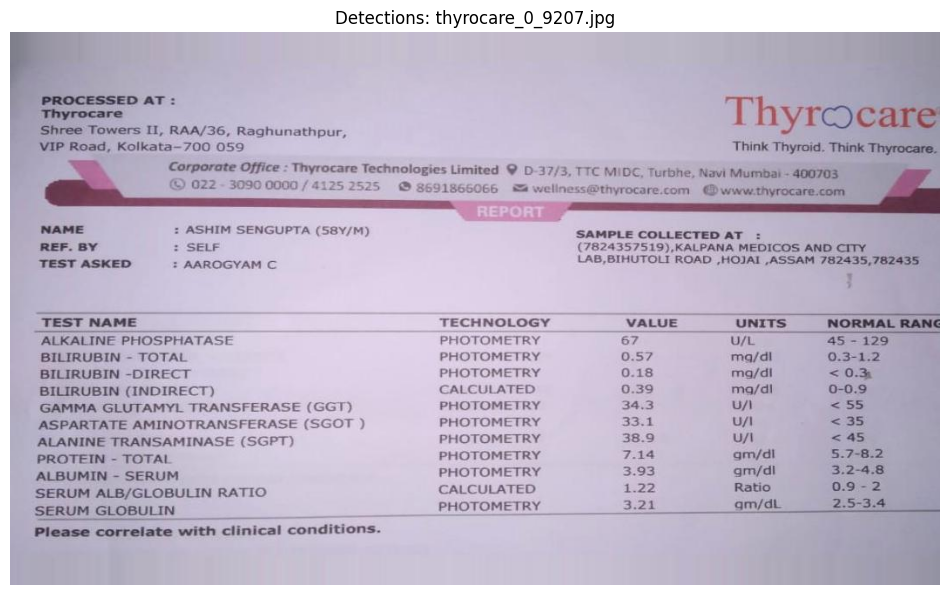


Processing image 2/82: thyrocare_0_9447.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9447.jpg


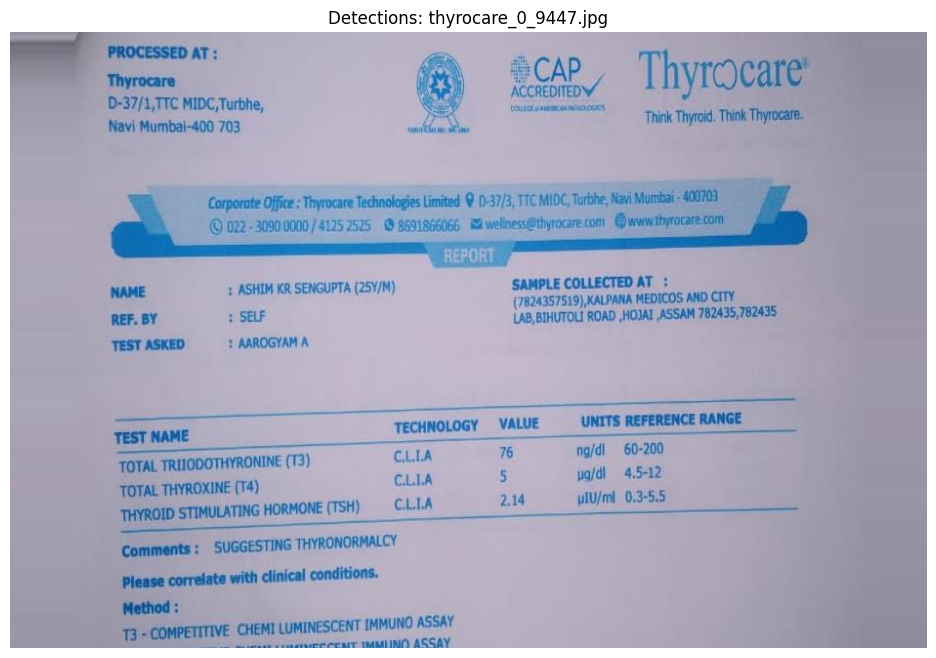


Processing image 3/82: thyrocare_0_9691.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9691.jpg


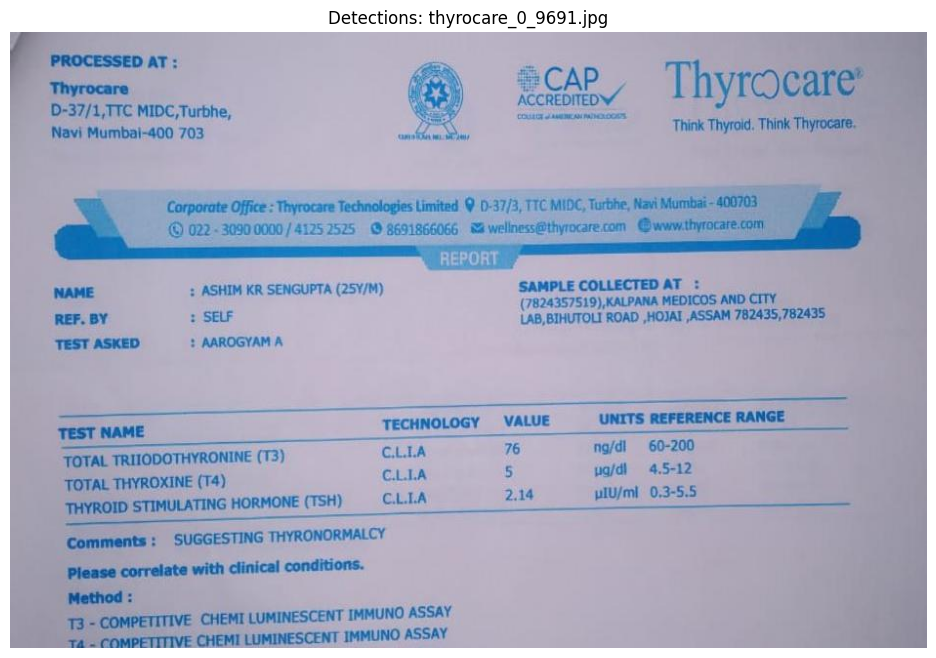


Processing image 4/82: thyrocare_0_9076.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9076.jpg


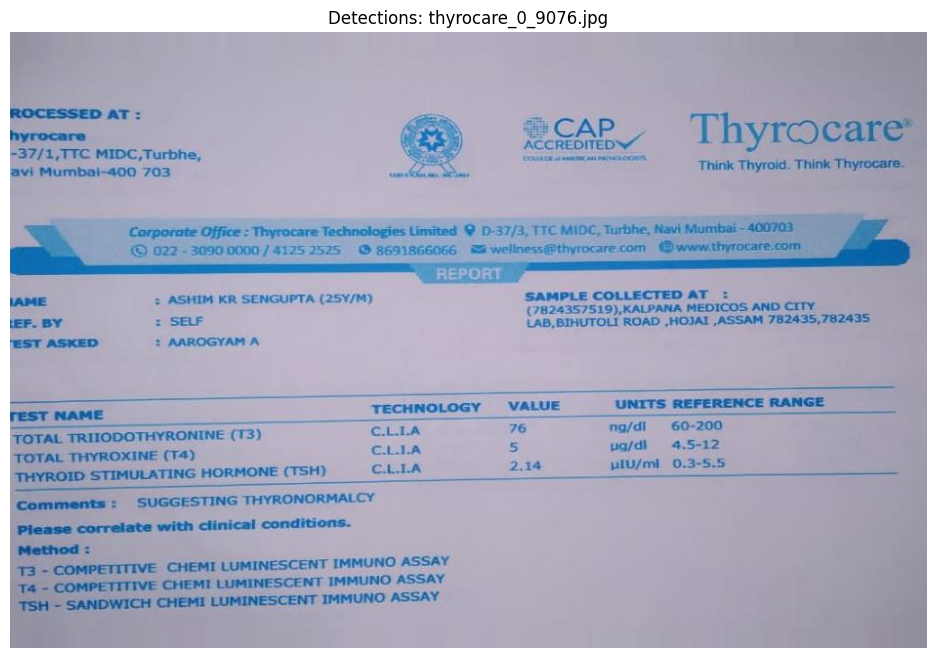


Processing image 5/82: thyrocare_0_7601.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7601.jpg


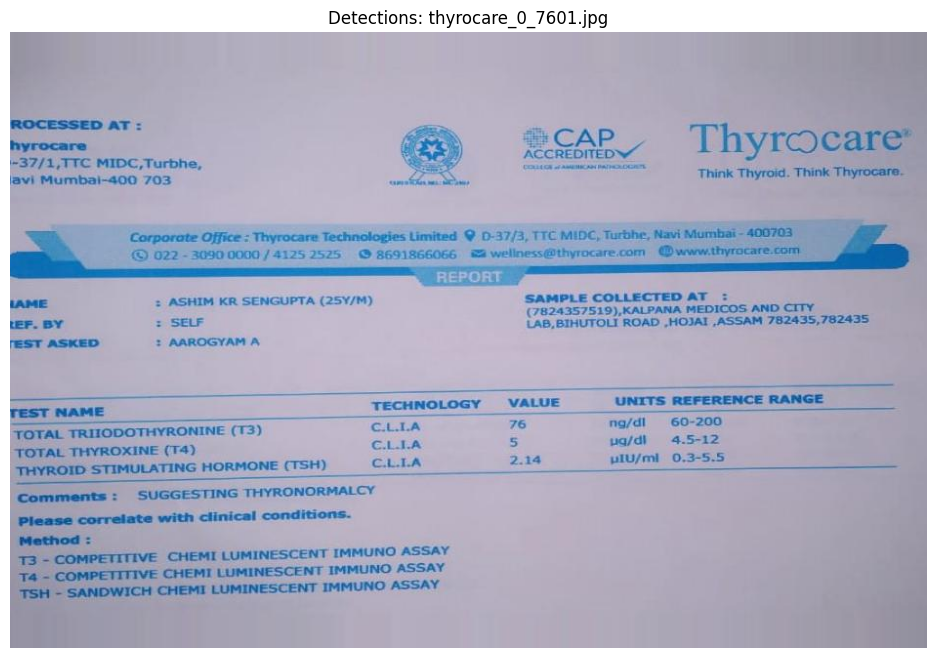


Processing image 6/82: thyrocare_0_7109.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7109.jpg


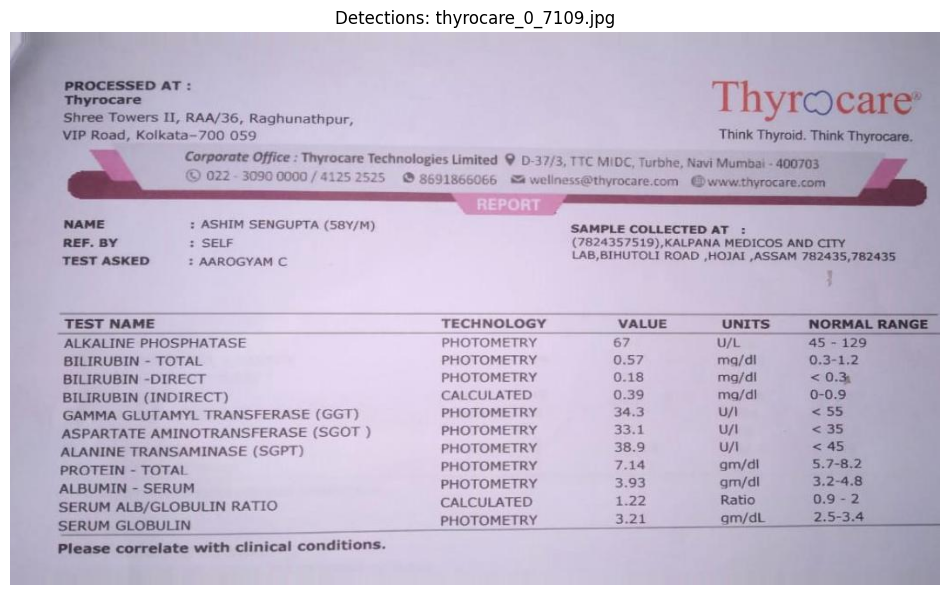


Processing image 7/82: thyrocare_0_7791.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7791.jpg


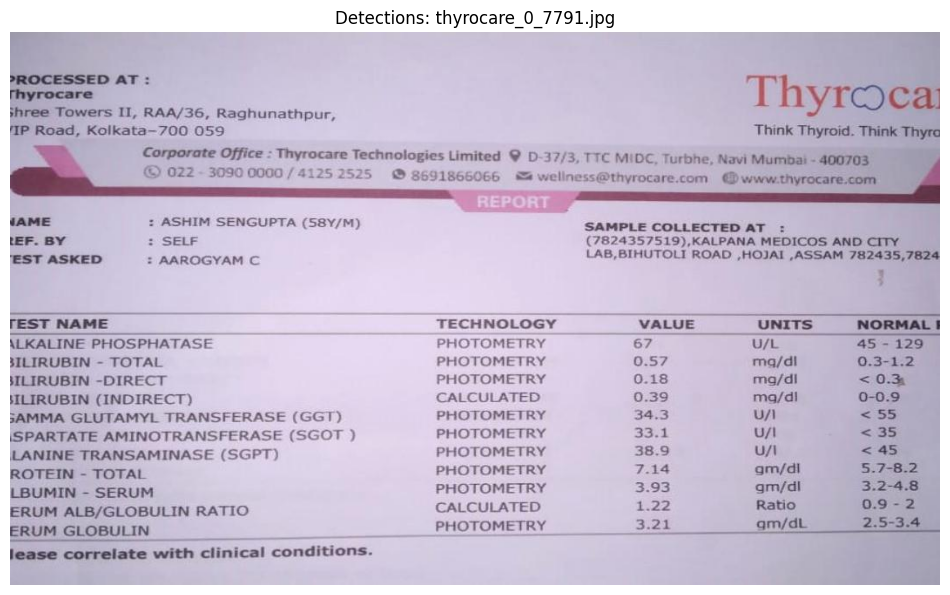


Processing image 8/82: thyrocare_0_7082.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7082.jpg


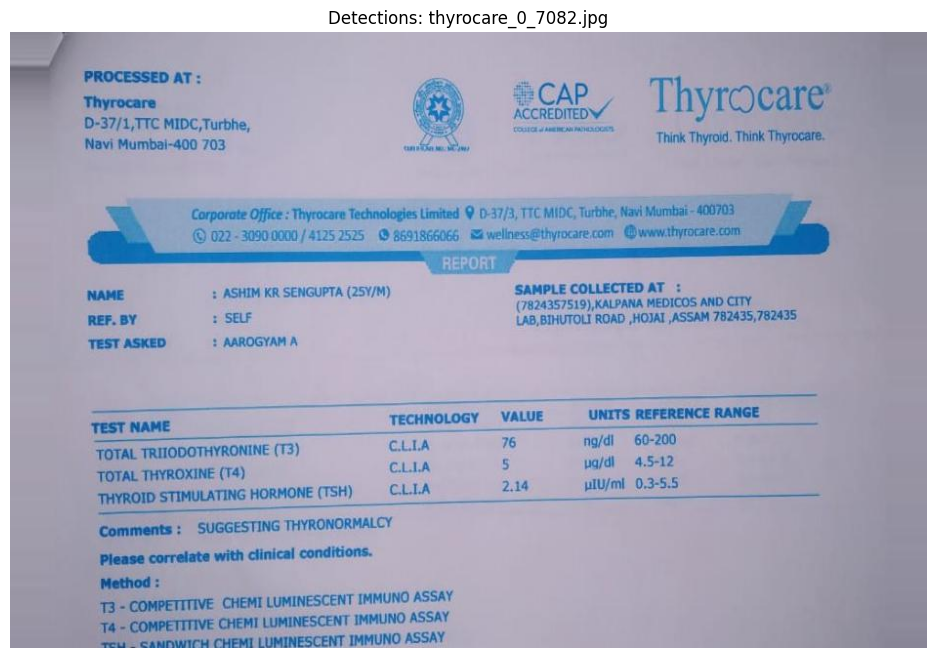


Processing image 9/82: thyrocare_0_7635.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7635.jpg


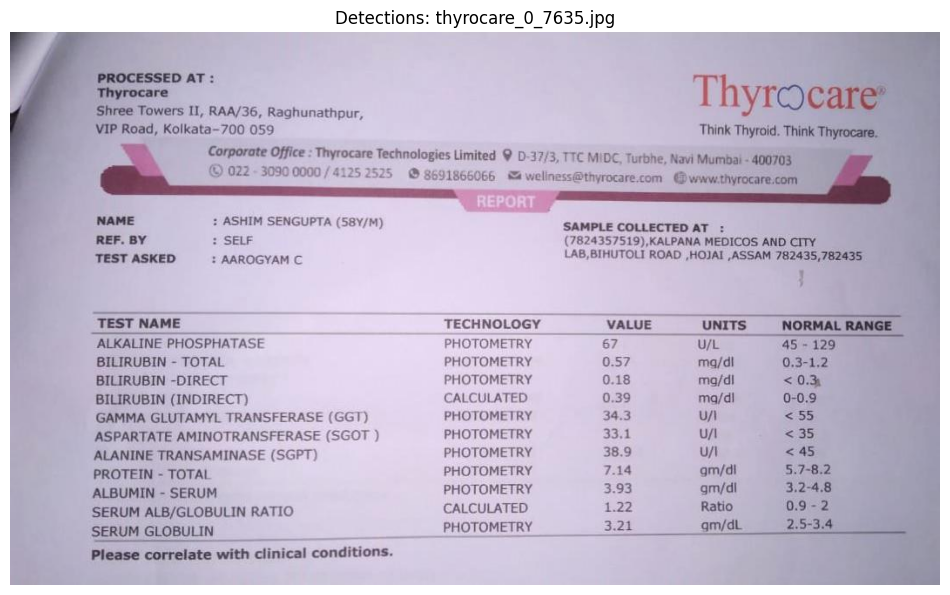


Processing image 10/82: thyrocare_0_7571.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7571.jpg


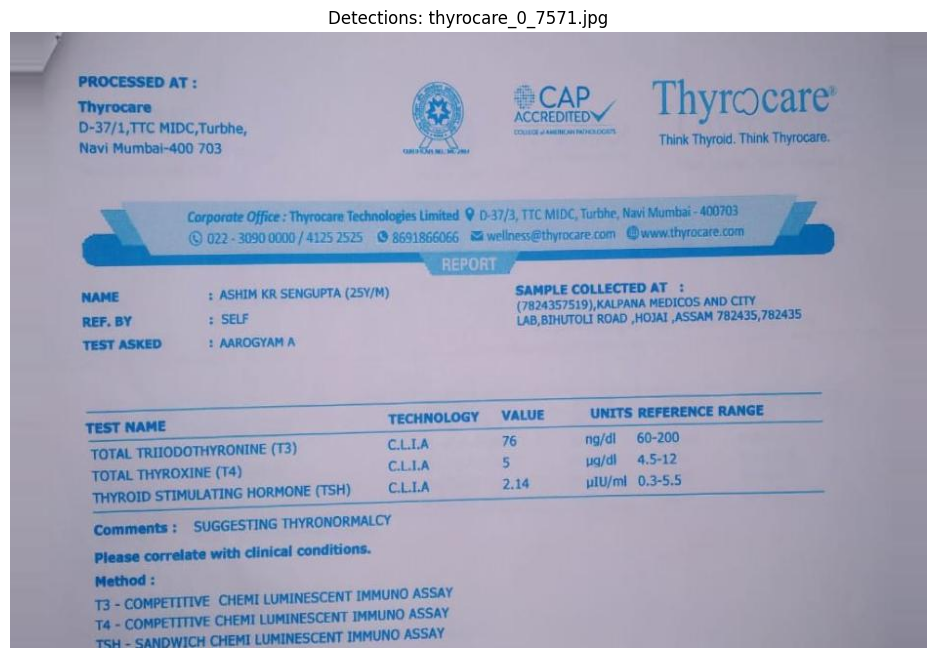


Processing image 11/82: thyrocare_0_7219.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7219.jpg


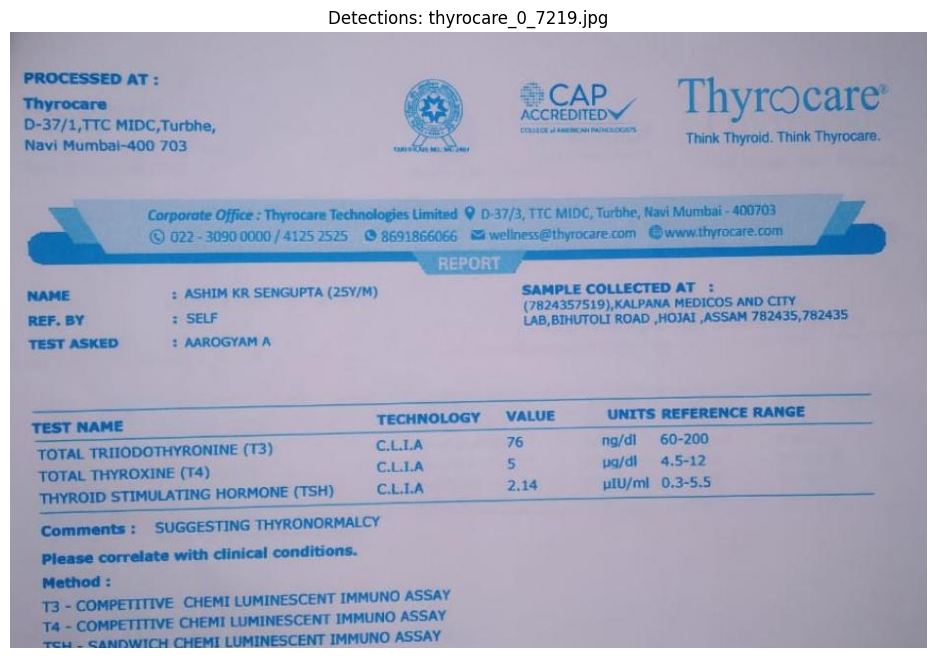


Processing image 12/82: thyrocare_0_8748.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8748.jpg


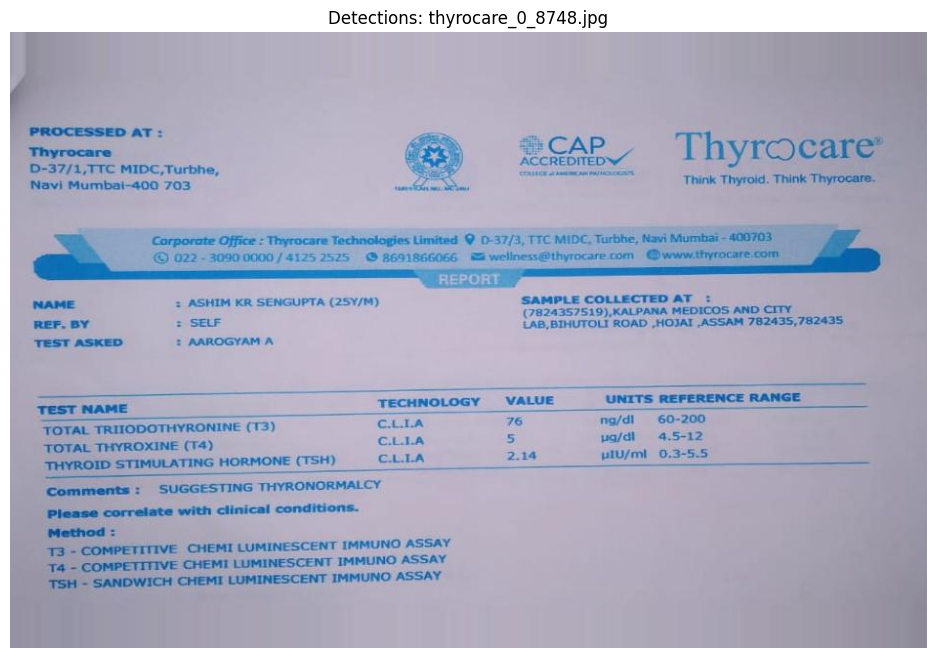


Processing image 13/82: thyrocare_0_8310.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.58)
  Text extracted: | oom on | =
oa mt Zi...
woe at =, OR Cn
Olen tay iiated >, grr ae:
: oy oe Vr SER Ang eee ‘Thbals F...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8310.jpg


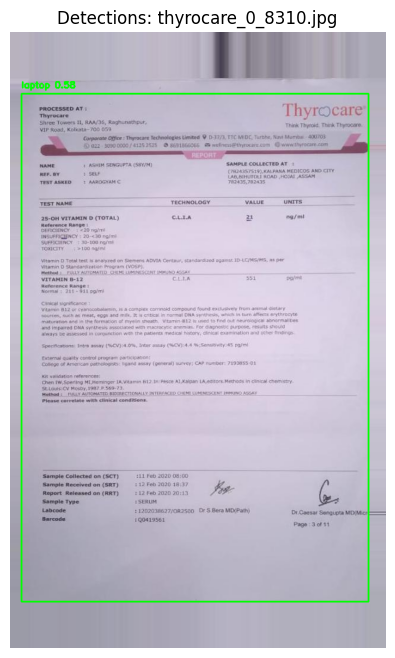


Processing image 14/82: thyrocare_0_8214.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8214.jpg


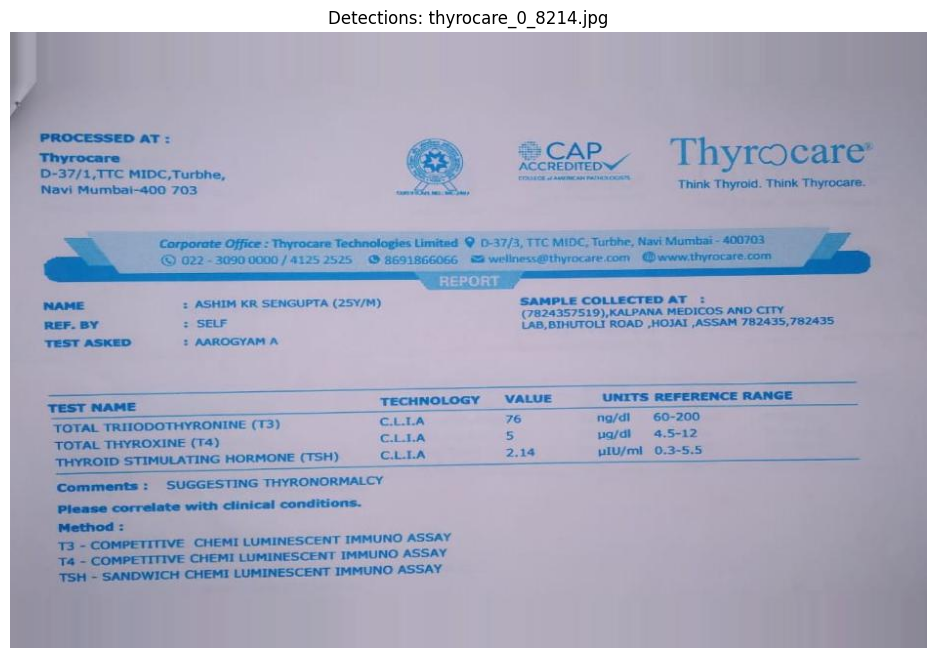


Processing image 15/82: thyrocare_0_8265.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.71)
  Text extracted: wy ke Pree vor Ooetell 7 ee
oe vie ee RL Re Se SO TT ae Oe a NP a PY y PPA eT Ty ane
- REPORT
wane 2...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8265.jpg


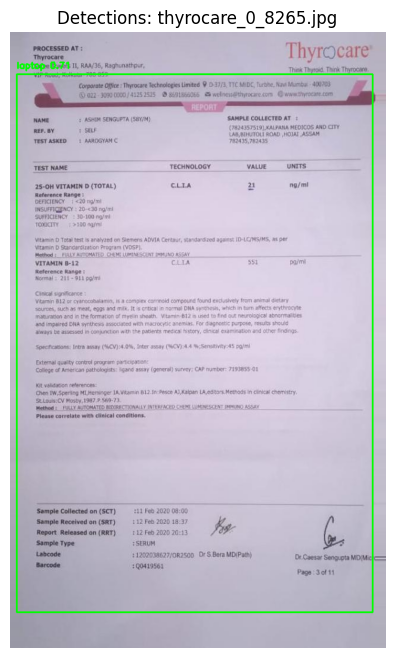


Processing image 16/82: thyrocare_0_8302.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8302.jpg


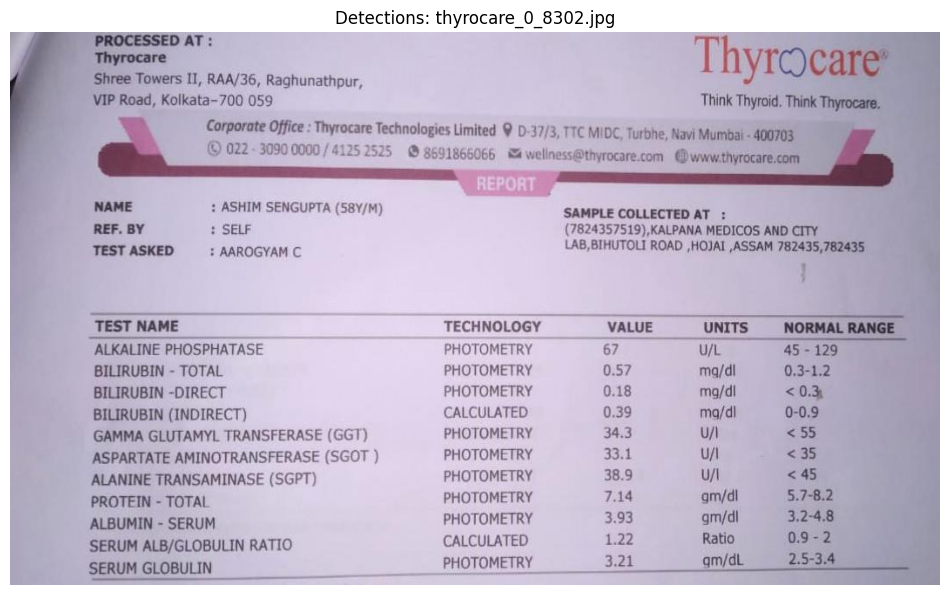


Processing image 17/82: thyrocare_0_7805.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7805.jpg


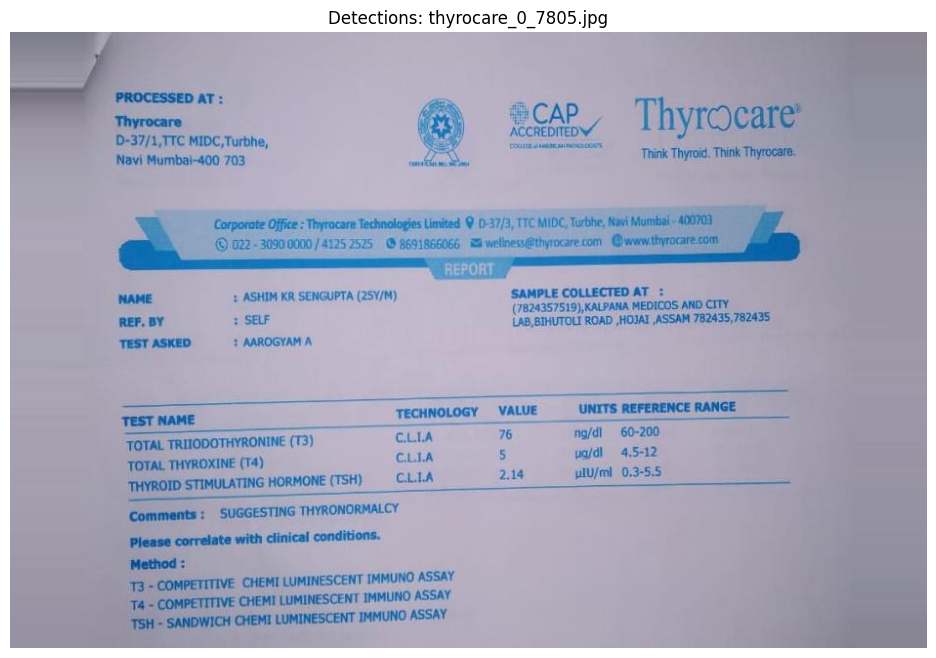


Processing image 18/82: thyrocare_0_8231.jpg
Detected 1 objects
  Object 1: laptop (conf: 0.72)
  Text extracted: REPORT
HANS ¢ ASHIM SENGUPTA (S8Y/M) SAMPLE COLLECTED AY :
; mot Pe, PO KGYESU Re PE se ee! waa!

ee...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8231.jpg


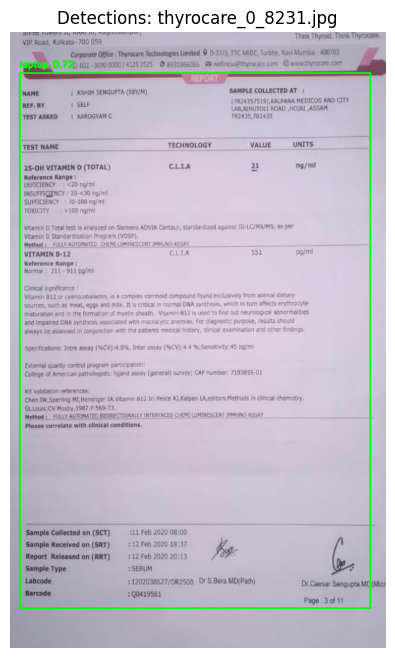


Processing image 19/82: thyrocare_0_8491.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.68)
  Text extracted: wT - cnt on Be 1. Yeu -
Cassiae fag BGR Agel ere cy
oad. tS arte aatat
eR odpe bgs smaameiaaall Pe.
...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8491.jpg


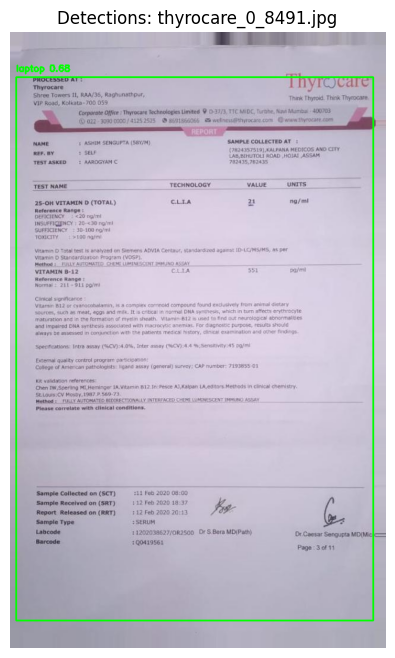


Processing image 20/82: thyrocare_0_8394.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8394.jpg


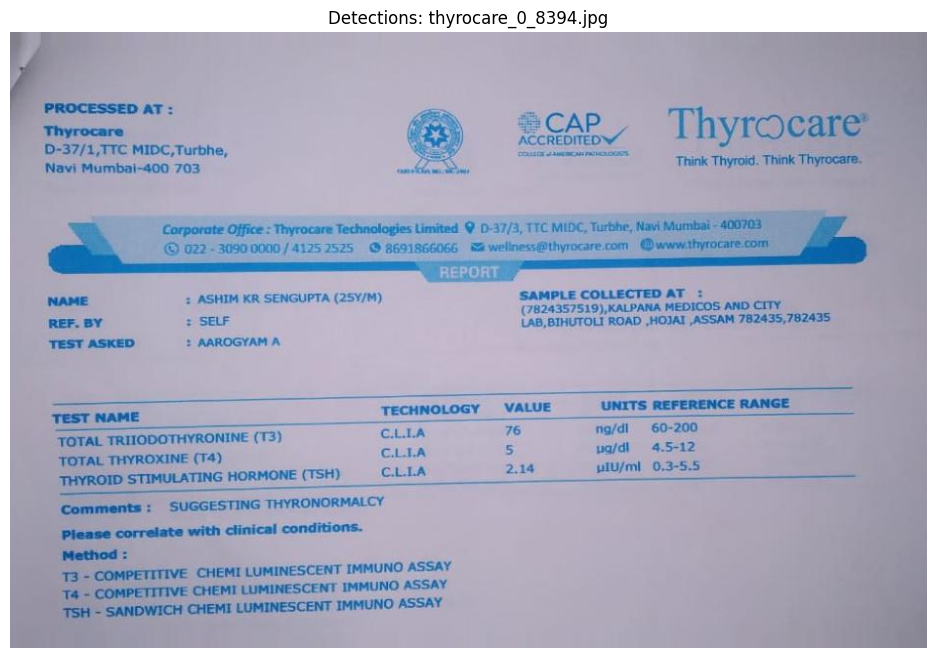


Processing image 21/82: thyrocare_0_8251.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8251.jpg


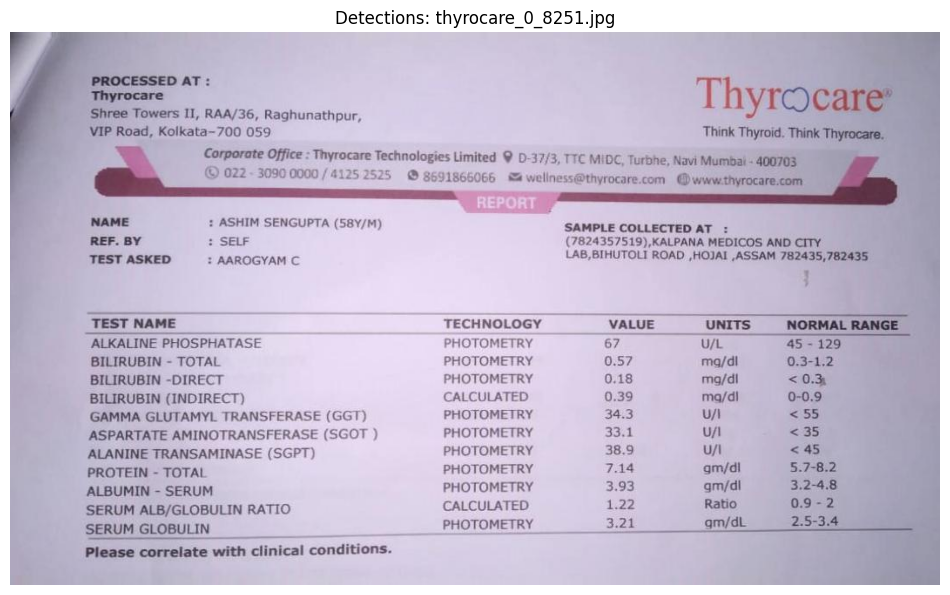


Processing image 22/82: thyrocare_0_9575.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9575.jpg


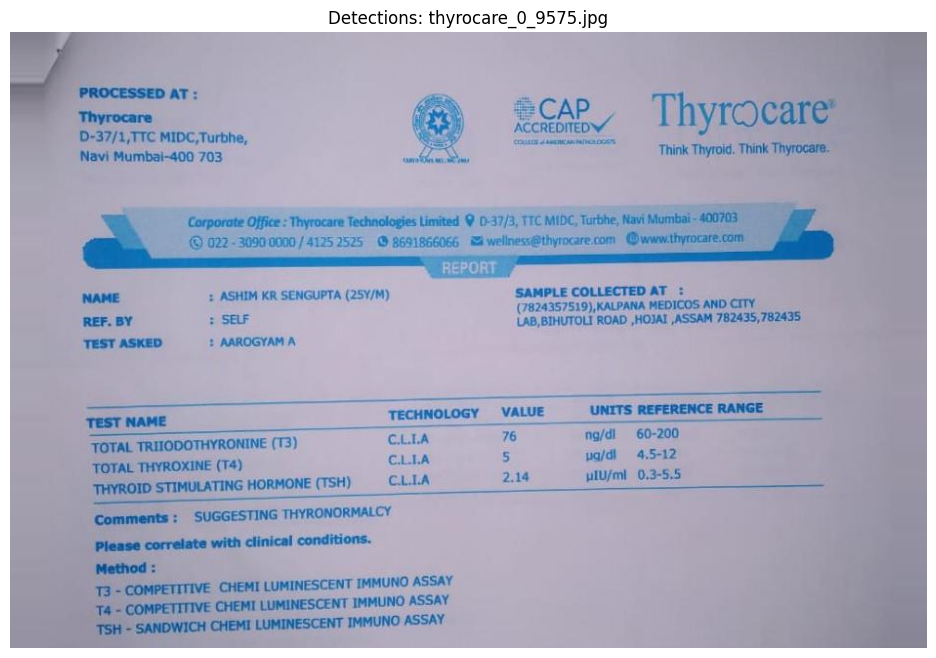


Processing image 23/82: thyrocare_0_9445.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.64)
  Text extracted: i
peo oo rr ek
“eet 7 ga BGR Use lOre et -
Oo is Leia RaunegNe, IRE. JDRGRI Kn;
. wry RT yp ansecbey...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9445.jpg


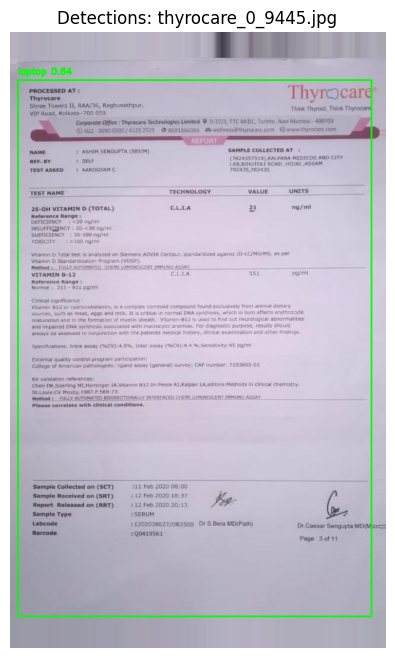


Processing image 24/82: thyrocare_0_9833.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9833.jpg


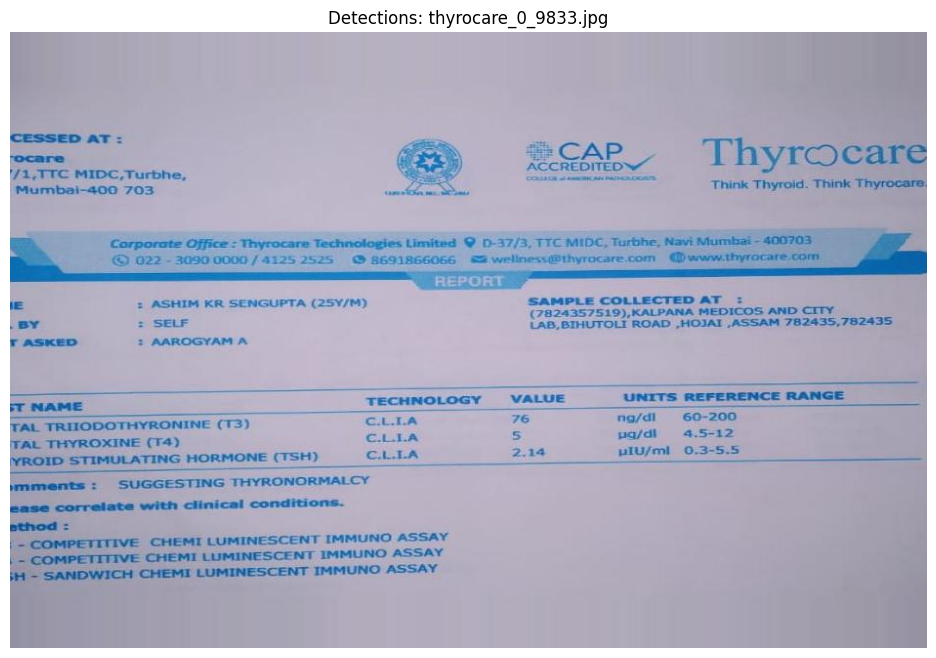


Processing image 25/82: thyrocare_0_9108.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9108.jpg


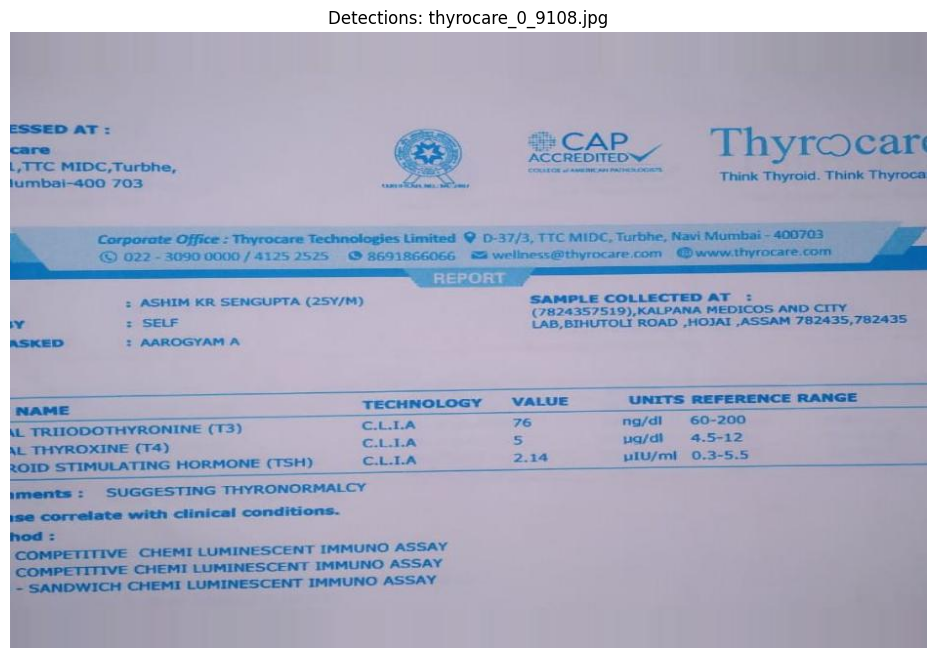


Processing image 26/82: thyrocare_0_9047.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_9047.jpg


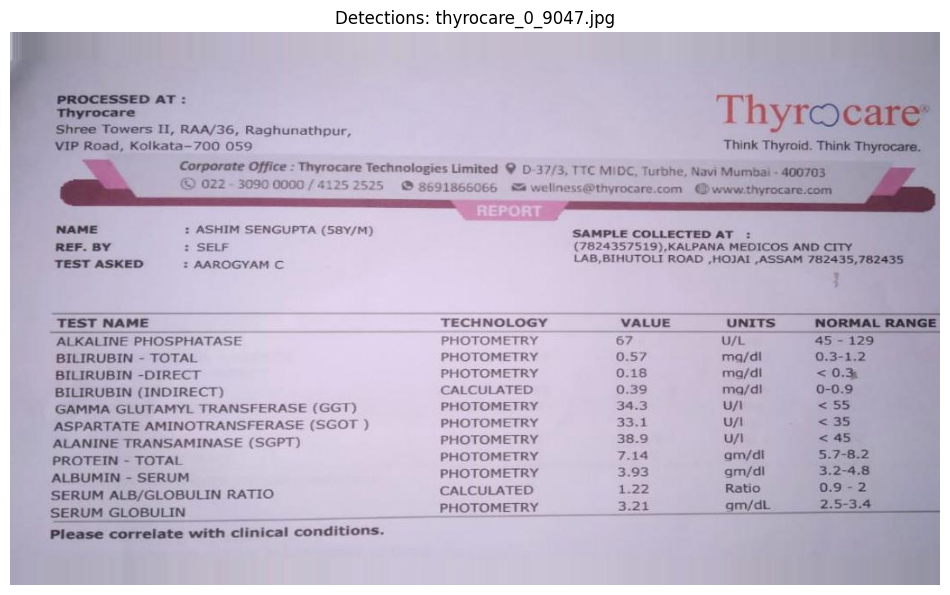


Processing image 27/82: thyrocare_0_8749.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_8749.jpg


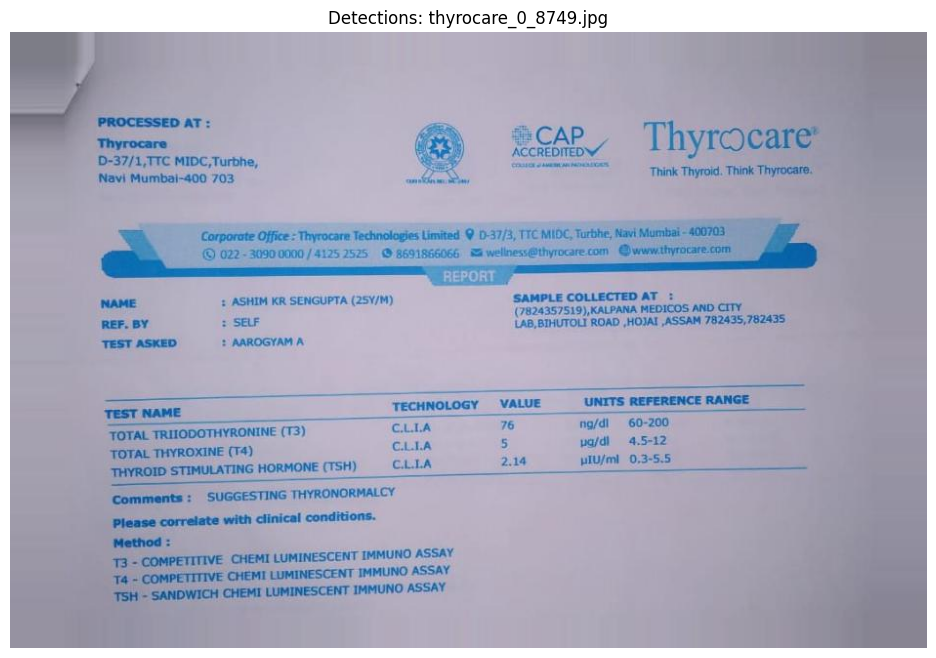


Processing image 28/82: thyrocare_0_1915.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.77)
  Text extracted: A BN ds Ba 5 NRTA VOLES Veen i ae ee - = " a RPG FO
ee ee ene ne ee Fh eoempmmncisn tansahernsisliln...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_1915.jpg


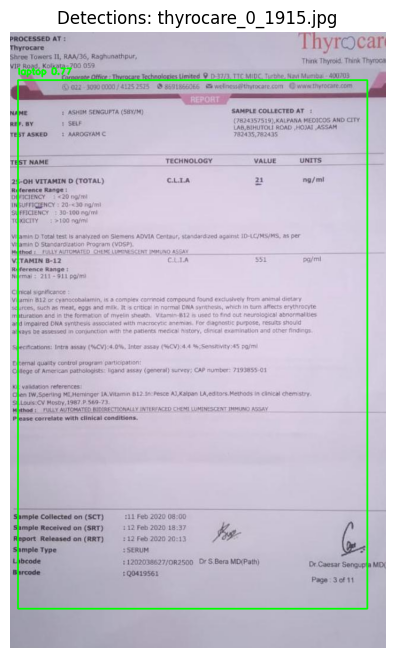


Processing image 29/82: thyrocare_0_912.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_912.jpg


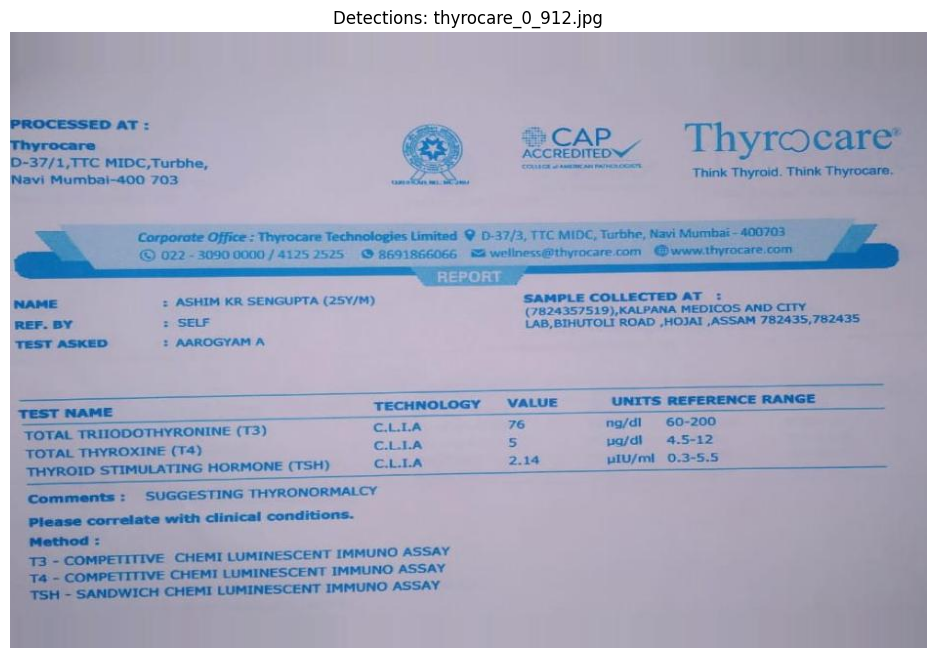


Processing image 30/82: thyrocare_0_1374.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_1374.jpg


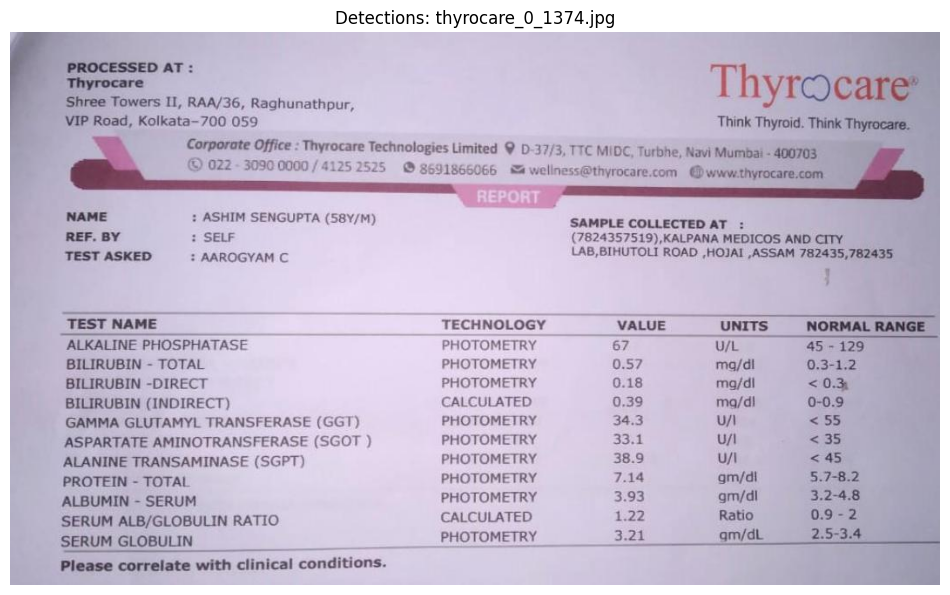


Processing image 31/82: thyrocare_0_2737.jpg
Detected 1 objects
  Object 0: book (conf: 0.50)
  Text extracted: = "pila ieieet ELITES eT UT af a
be eeuiie) Think Thyeold, Thiele ome
: el caltede eet R eh RUNG Ra ...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2737.jpg


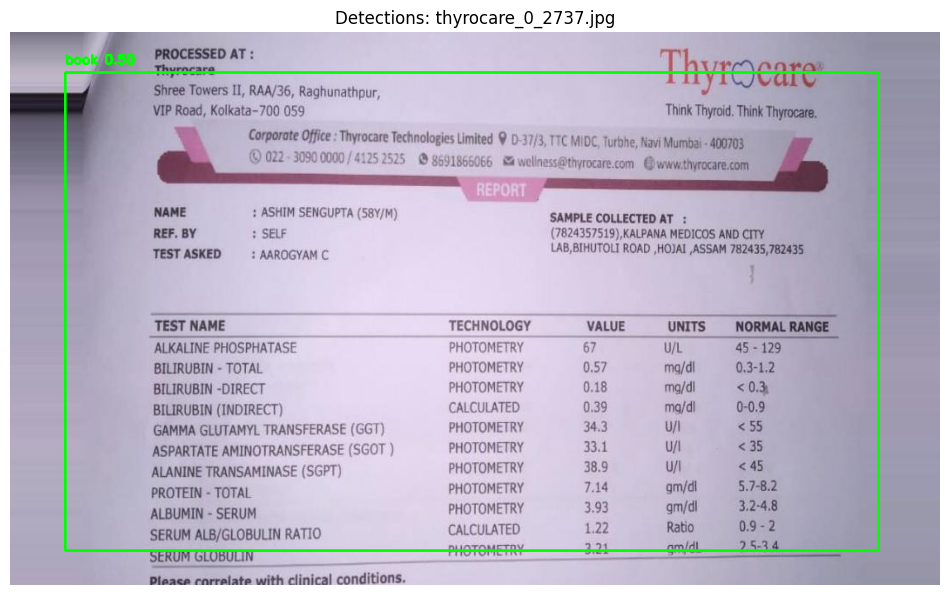


Processing image 32/82: thyrocare_0_2177.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2177.jpg


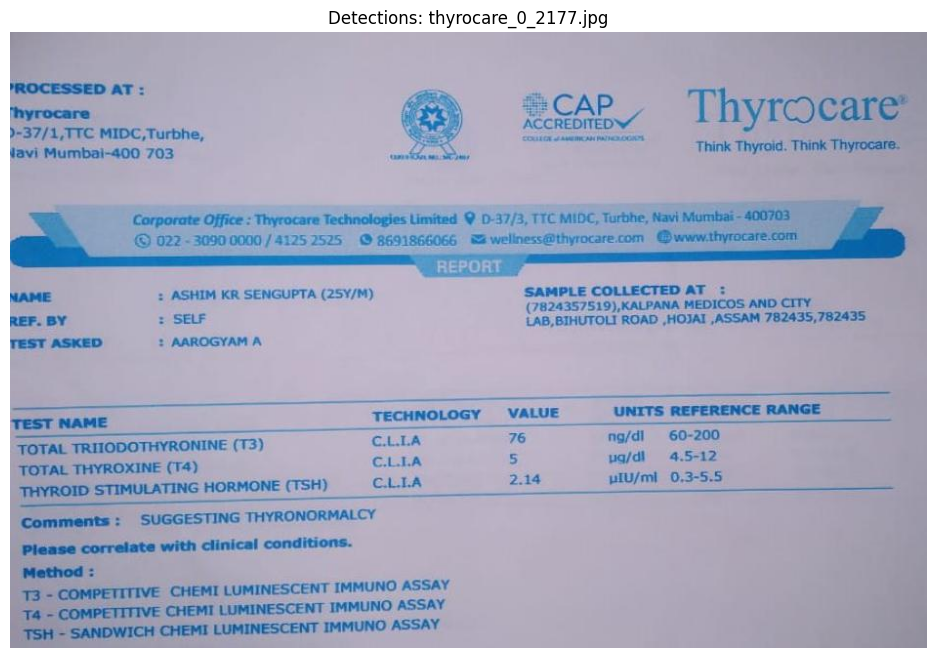


Processing image 33/82: thyrocare_0_2691.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2691.jpg


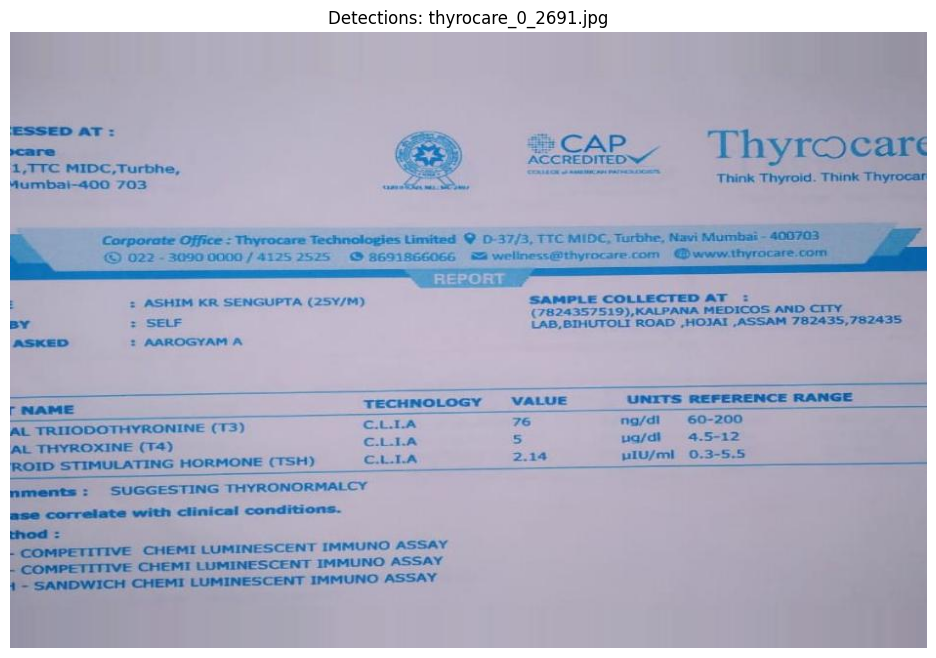


Processing image 34/82: thyrocare_0_2505.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2505.jpg


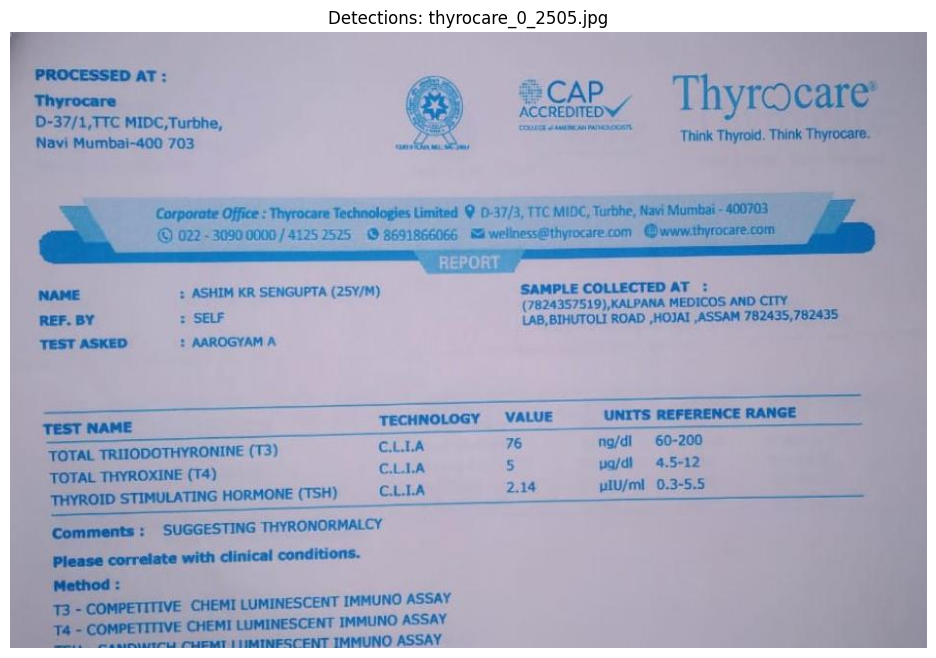


Processing image 35/82: thyrocare_0_2841.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2841.jpg


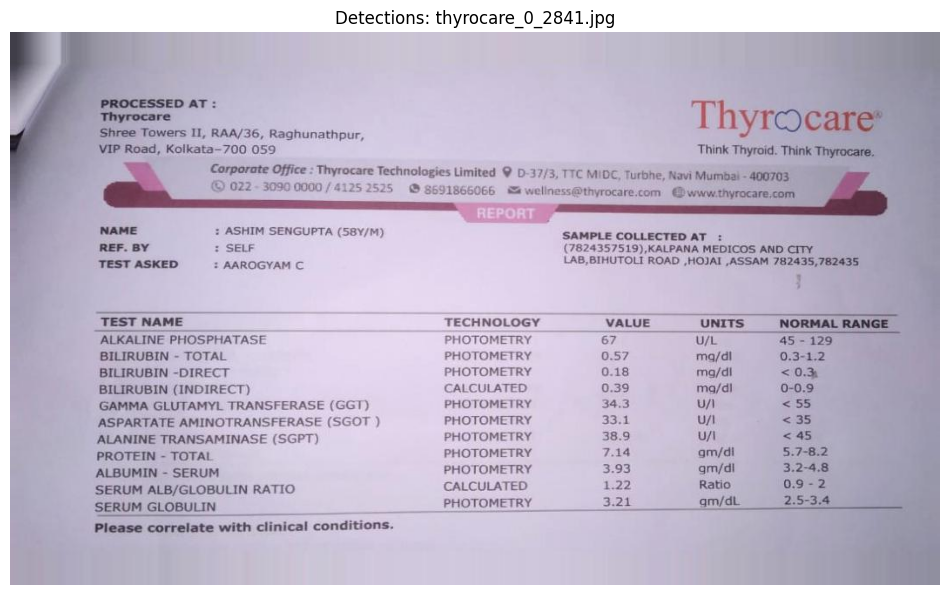


Processing image 36/82: thyrocare_0_2838.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.66)
  Text extracted: T ia
-@ bed .7 .
Se o us j ee hed
re 2p eee ane "sa
RC iene cas Tshann nko,
uo A WEE ne TEES aes Cr ...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2838.jpg


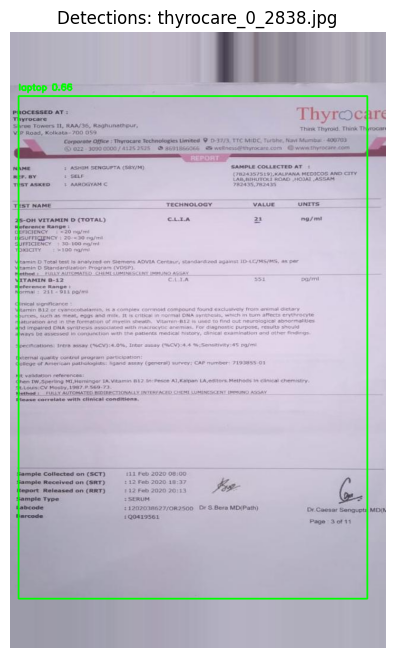


Processing image 37/82: thyrocare_0_2649.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2649.jpg


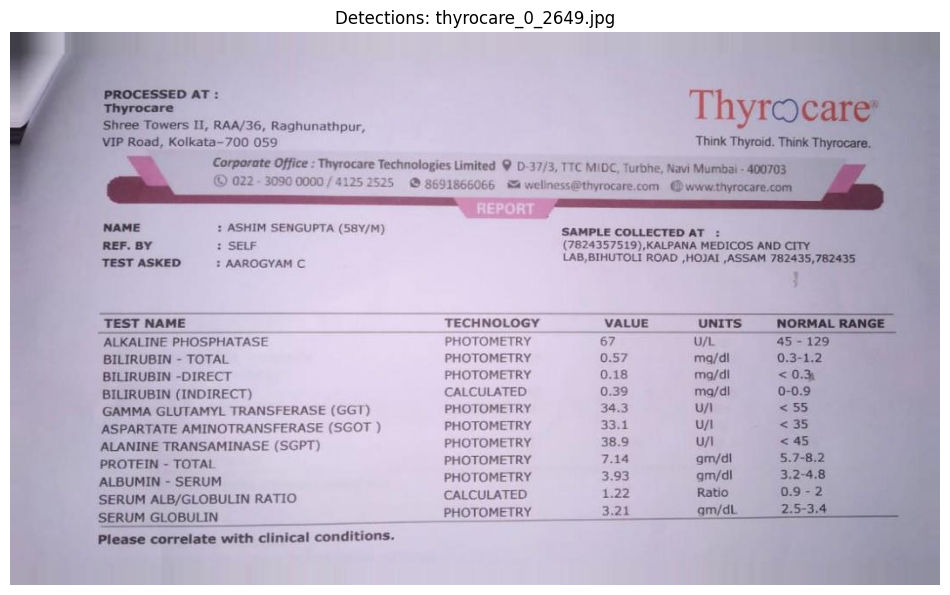


Processing image 38/82: thyrocare_0_3804.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_3804.jpg


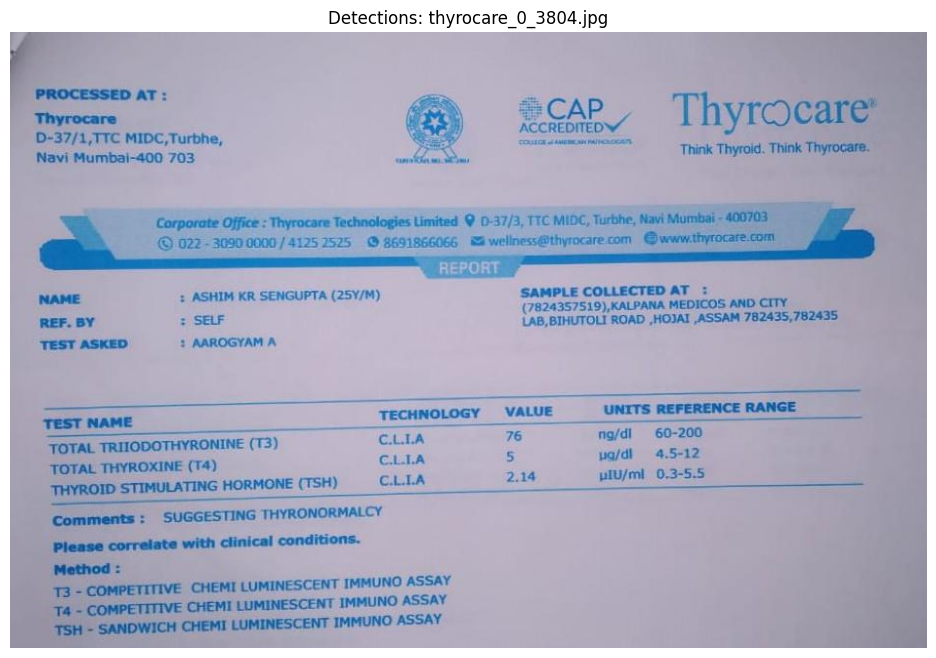


Processing image 39/82: thyrocare_0_3558.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_3558.jpg


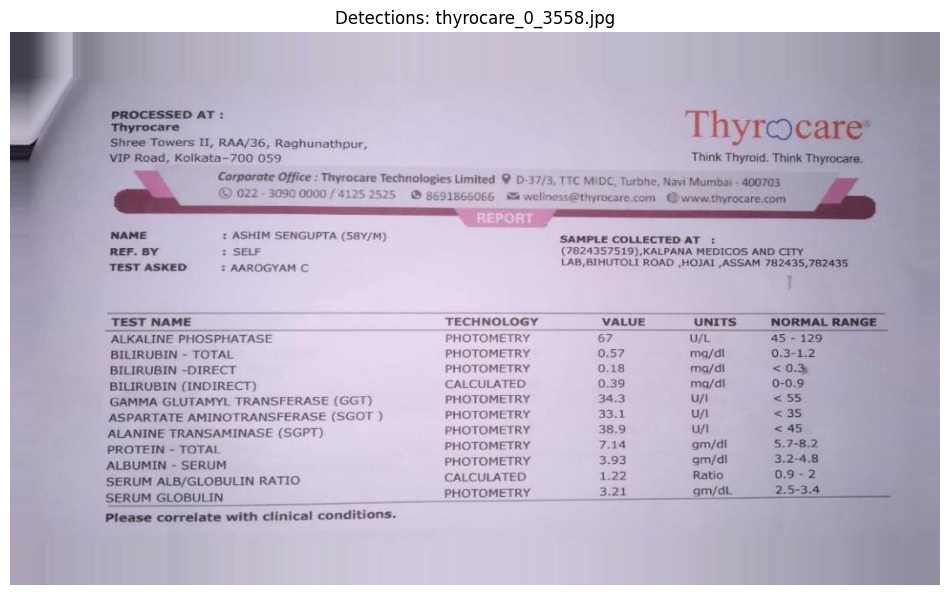


Processing image 40/82: thyrocare_0_3333.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_3333.jpg


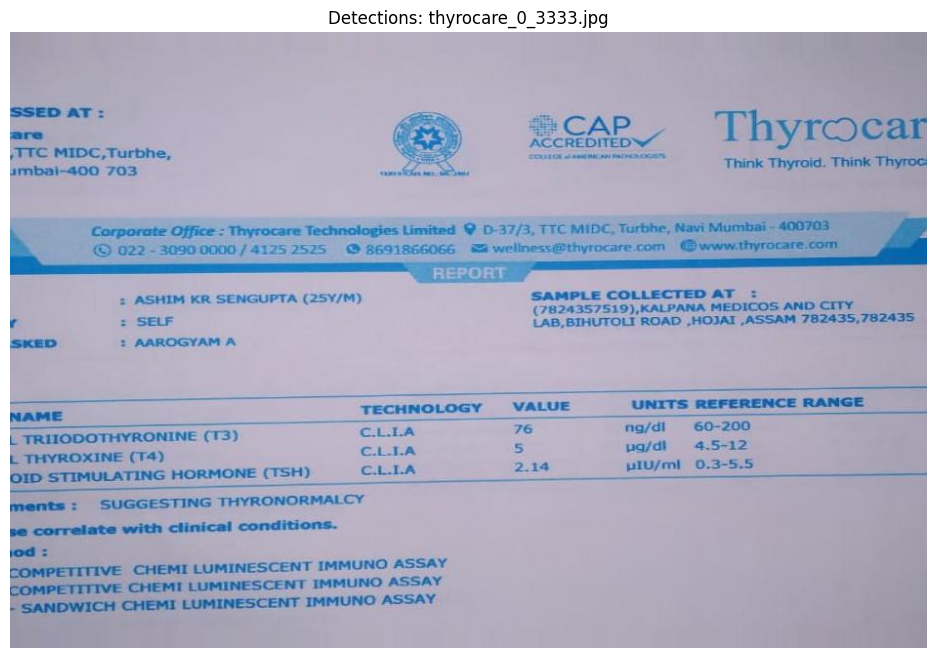


Processing image 41/82: thyrocare_0_3753.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_3753.jpg


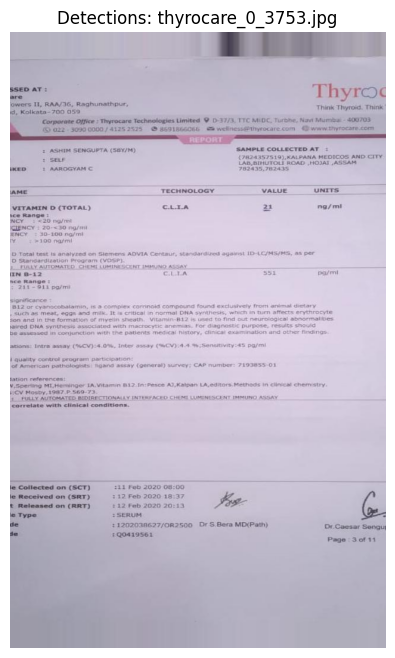


Processing image 42/82: thyrocare_0_1861.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_1861.jpg


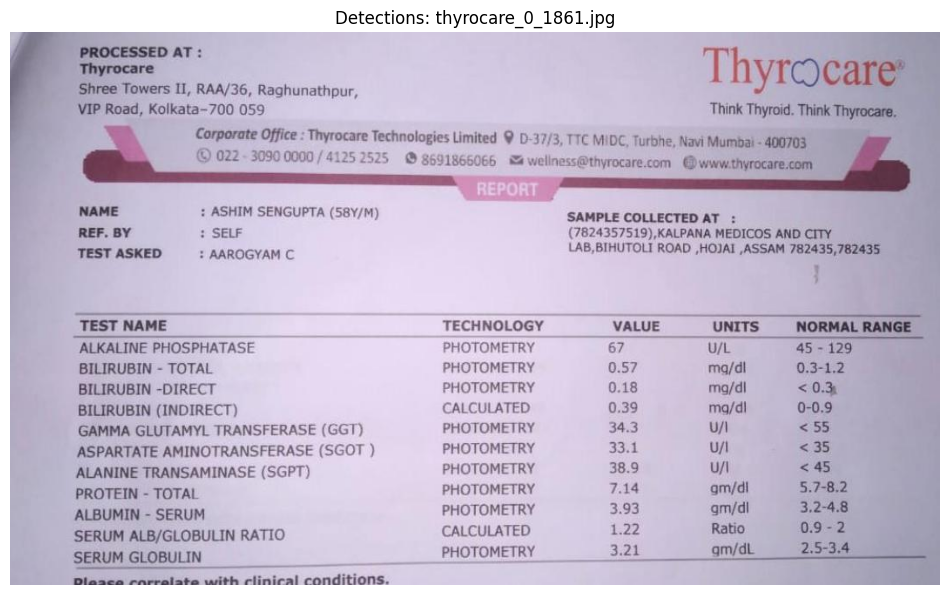


Processing image 43/82: thyrocare_0_2300.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2300.jpg


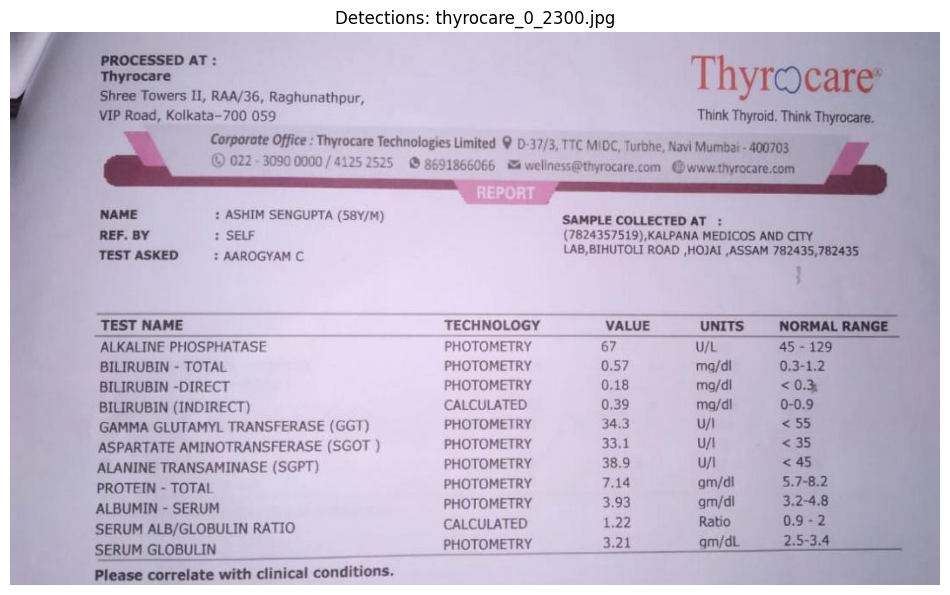


Processing image 44/82: thyrocare_0_3414.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.51)
  Text extracted: -, 7 ay y
" ef
a 7 a” |
: wile " PSB aie
vane es Wad ueG Ges. g°
/ _ OY eR i Oa — fae’
: eS panathnl...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_3414.jpg


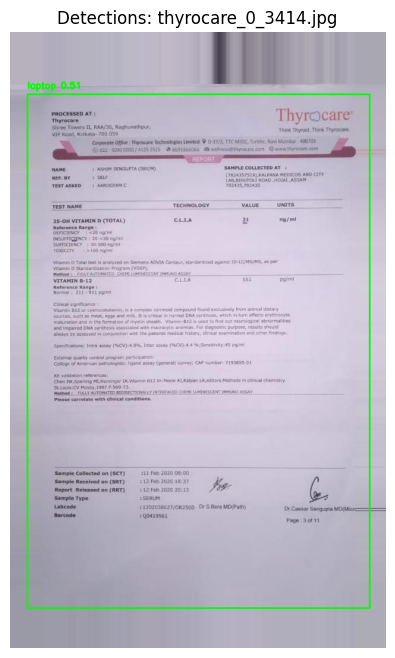


Processing image 45/82: thyrocare_0_3439.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_3439.jpg


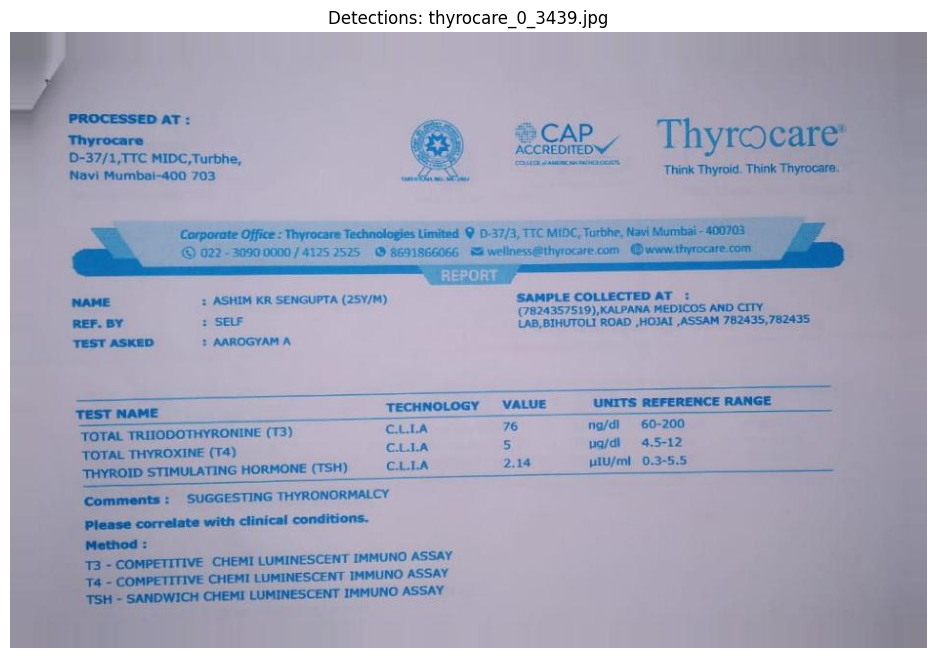


Processing image 46/82: thyrocare_0_4046.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.55)
  Text extracted: OL i page
on wo “PN age RY Te HEIR rs ry tet Ave ER Oe we . 7
Pon SS NER EAS pRFID Sosidio a ; pues ...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4046.jpg


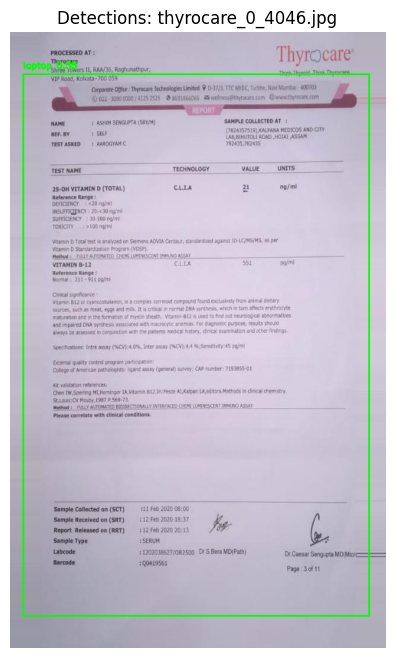


Processing image 47/82: thyrocare_0_2885.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2885.jpg


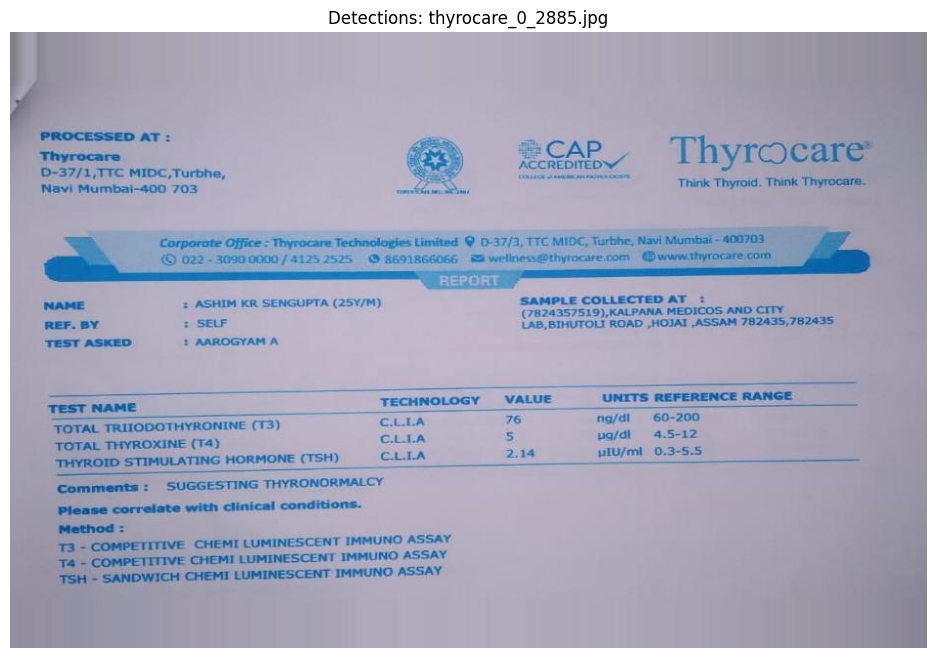


Processing image 48/82: thyrocare_0_2987.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.64)
  Text extracted: BP a + lila arg dog
—- Ce ET Nay go Oe AE Re Rey ye erees v4 - a. Pear . a
‘ So ee ee iy erin cekini...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_2987.jpg


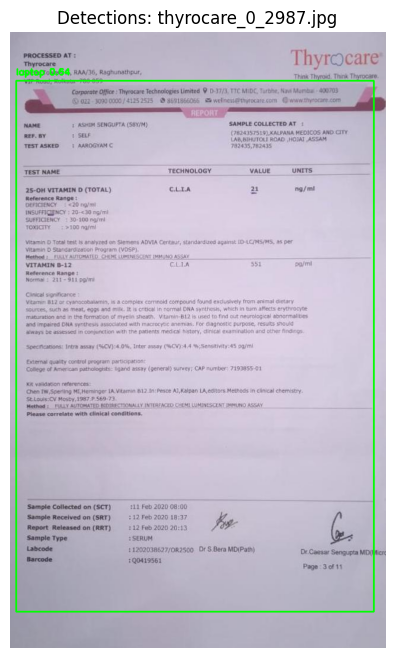


Processing image 49/82: thyrocare_0_3813.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_3813.jpg


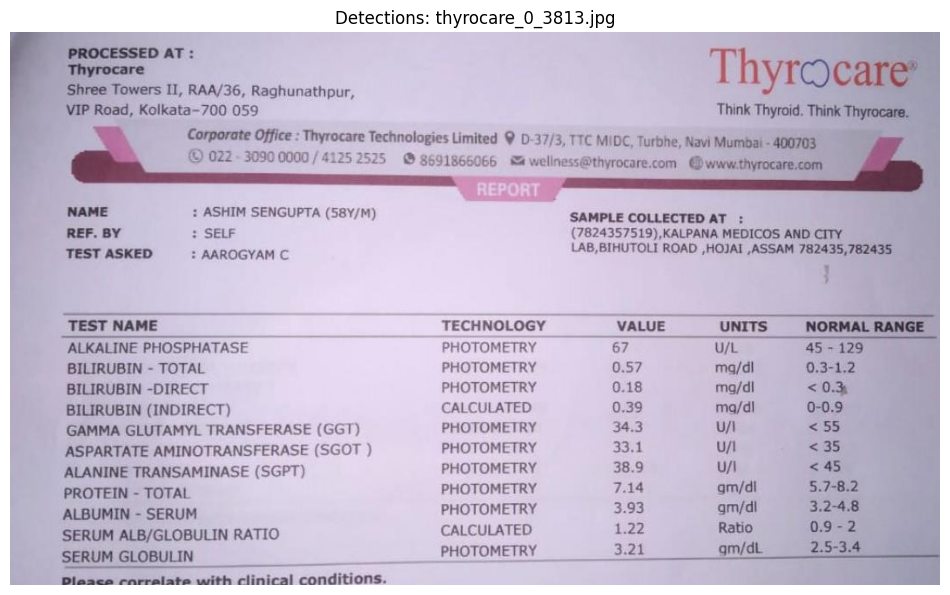


Processing image 50/82: thyrocare_0_4468.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4468.jpg


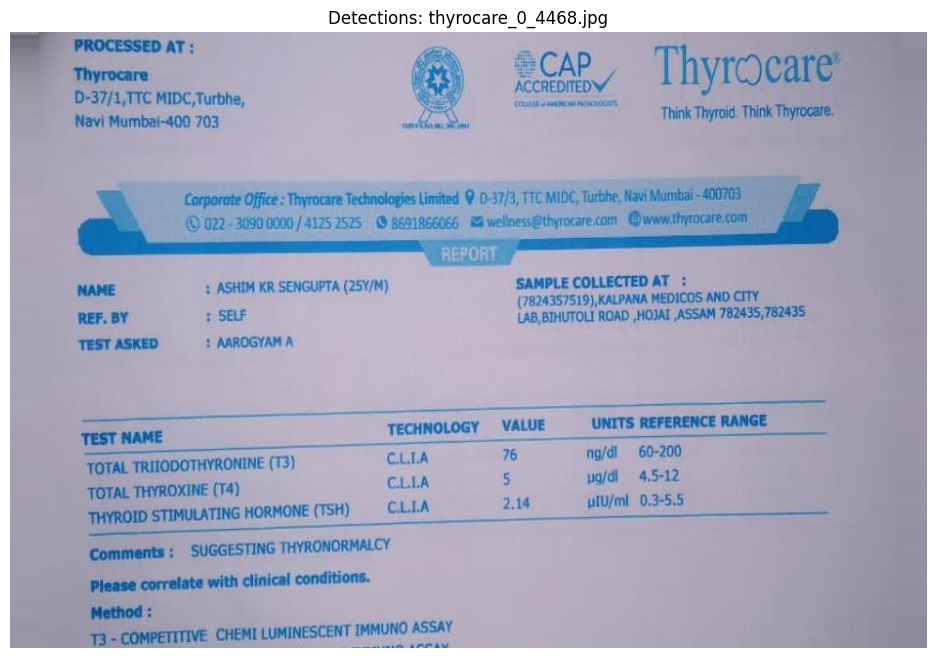


Processing image 51/82: thyrocare_0_4670.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4670.jpg


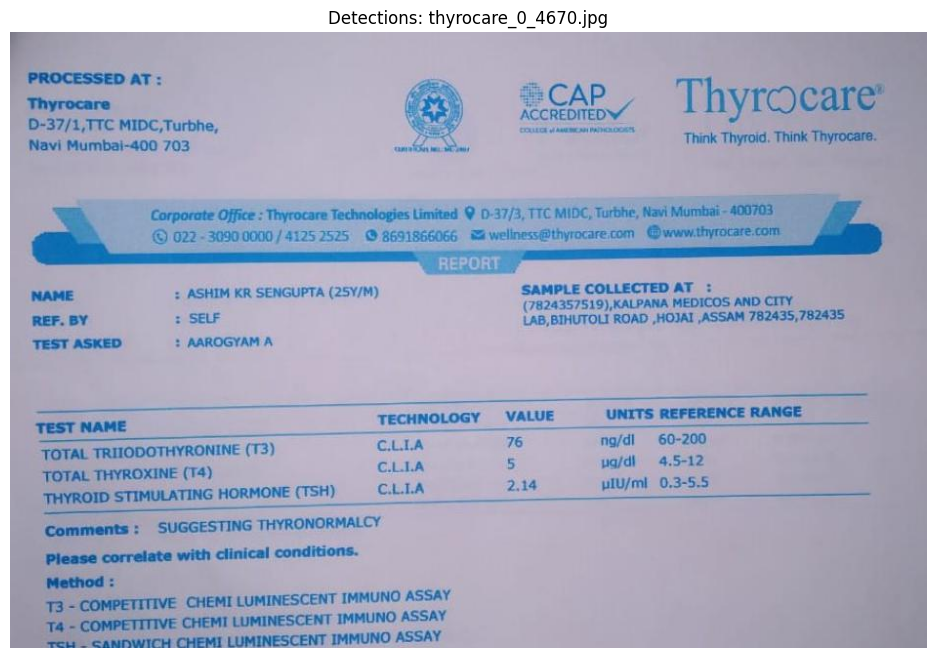


Processing image 52/82: thyrocare_0_4523.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.61)
  Text extracted: 3 AGHIM SENGUPTA (SB¥/M) SAMPLE COLLECTED AY :
a | (7824357519), KALPANA MEDICOS ANt
LAB, SIHUTOLI R...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4523.jpg


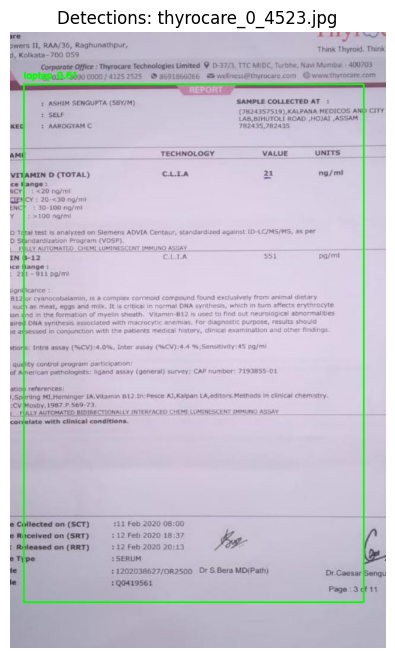


Processing image 53/82: thyrocare_0_4683.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4683.jpg


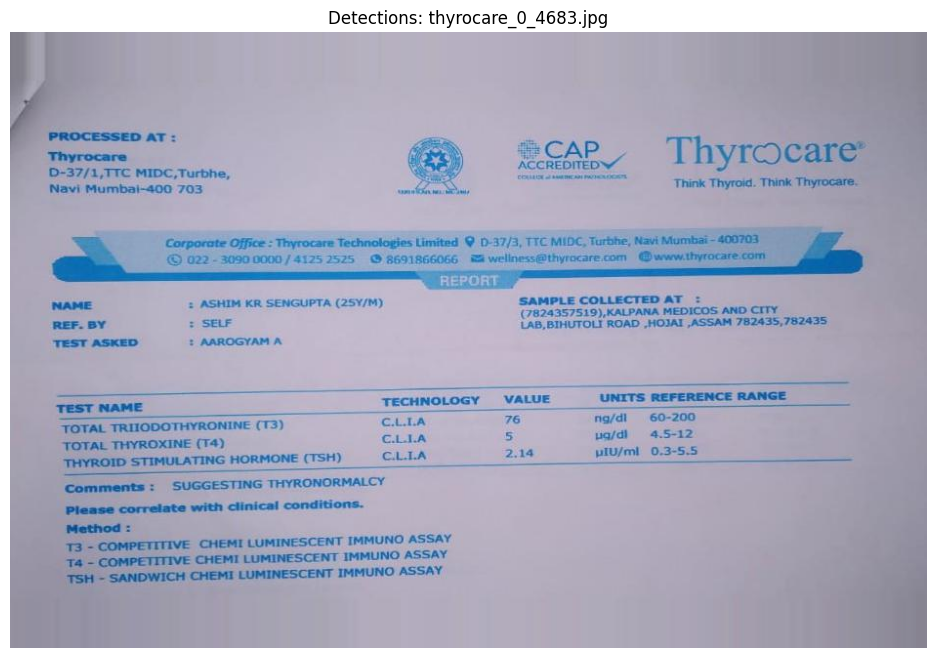


Processing image 54/82: thyrocare_0_4498.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4498.jpg


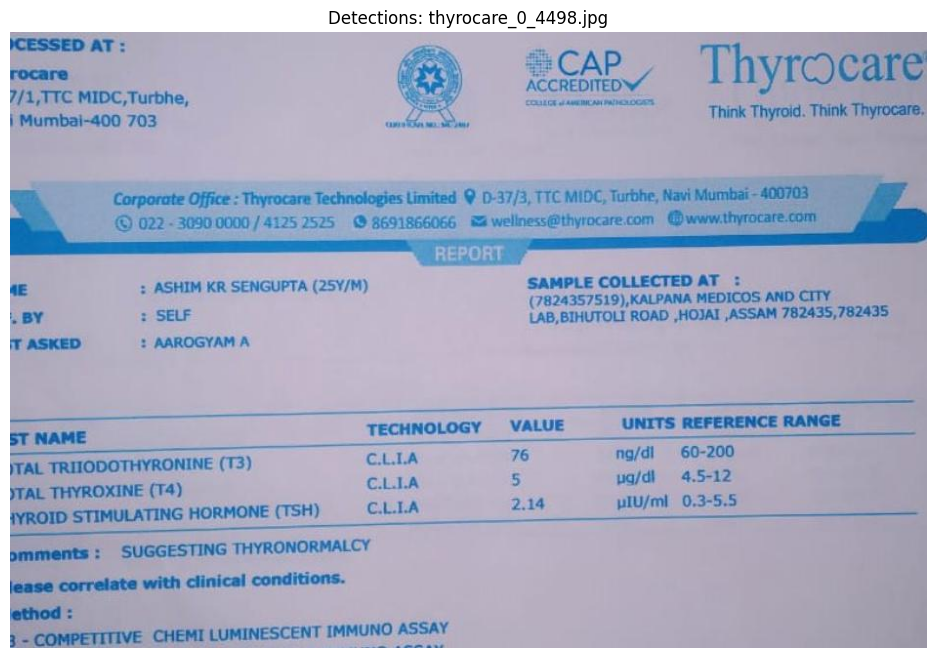


Processing image 55/82: thyrocare_0_4385.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4385.jpg


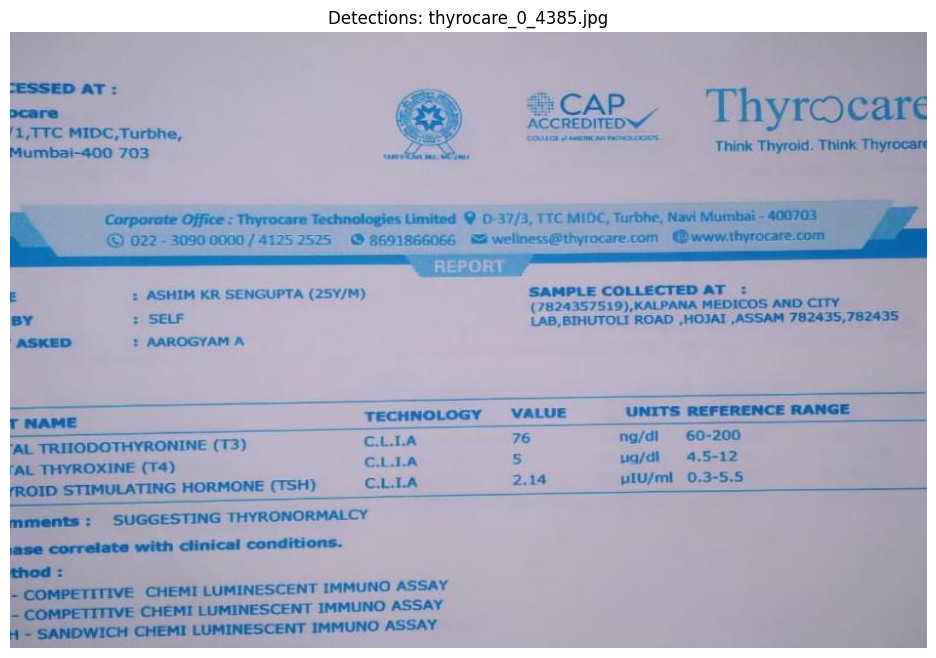


Processing image 56/82: thyrocare_0_4790.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4790.jpg


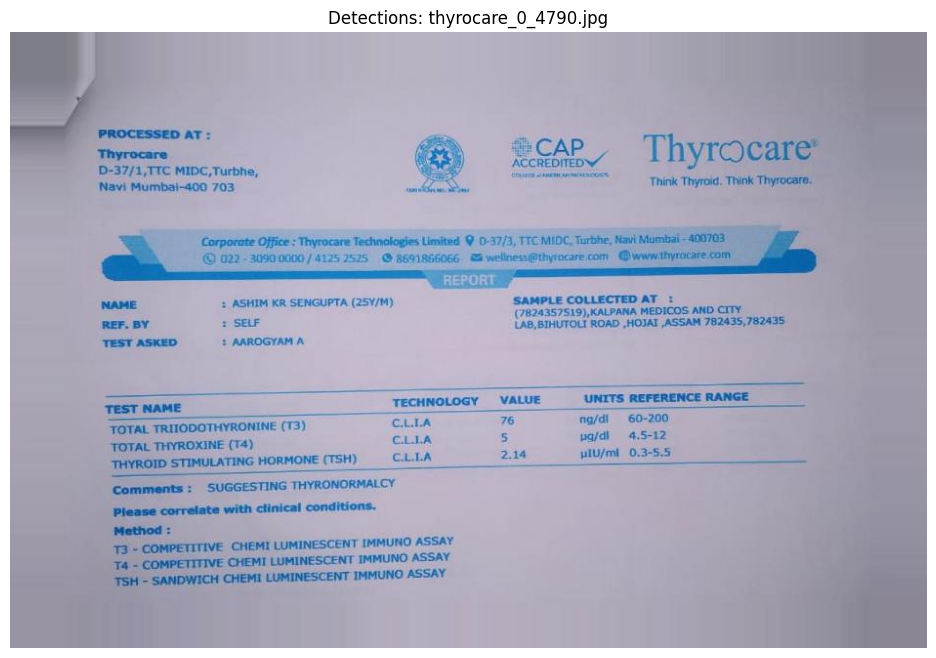


Processing image 57/82: thyrocare_0_4618.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4618.jpg


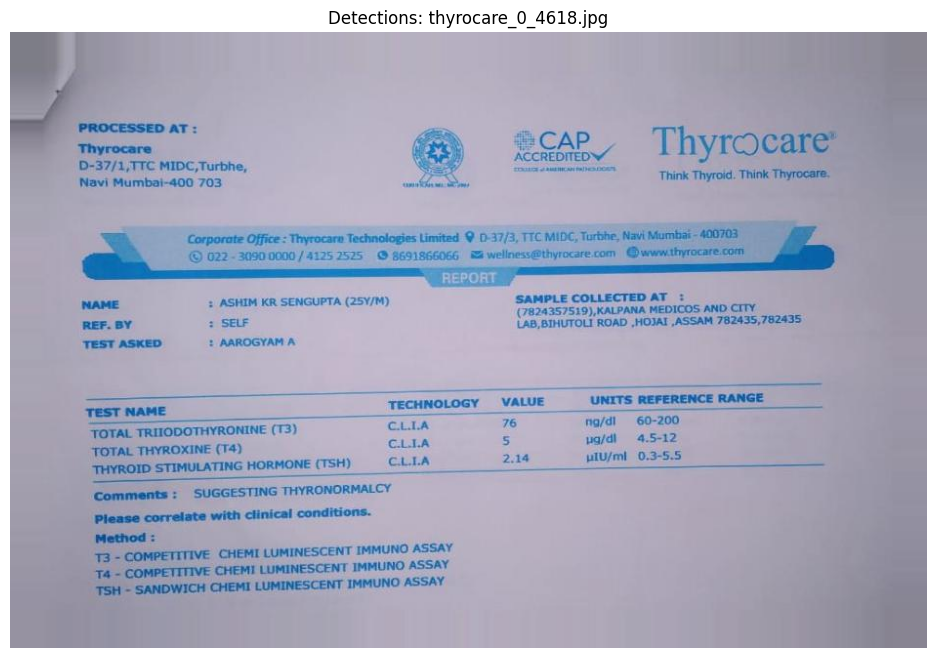


Processing image 58/82: thyrocare_0_4748.jpg
Detected 1 objects
  Object 1: laptop (conf: 0.73)
  Text extracted: Pole Ti ope Ghia 7h leg eee p . "
of ce wey ve IPS TYR A sha Nn re nw ZO OTA cee in
é + Eis [eh ethe...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4748.jpg


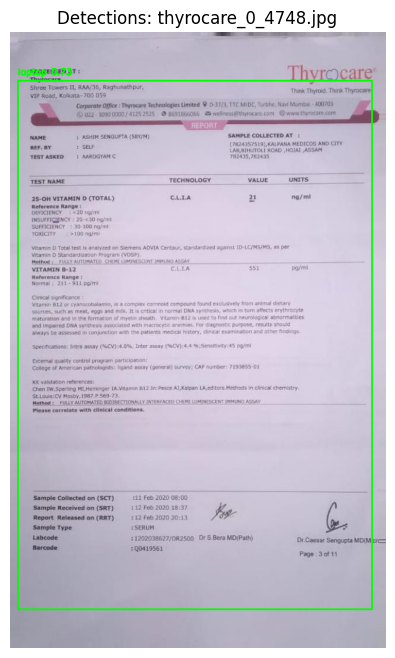


Processing image 59/82: thyrocare_0_5608.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.61)
  Text extracted: - 4 . - = — ™ re
ae - ; Oia
it~ ape oe el a} We divs Tal Mf
- ory i {AA Baga FE,
0 ECL el Li calidur...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5608.jpg


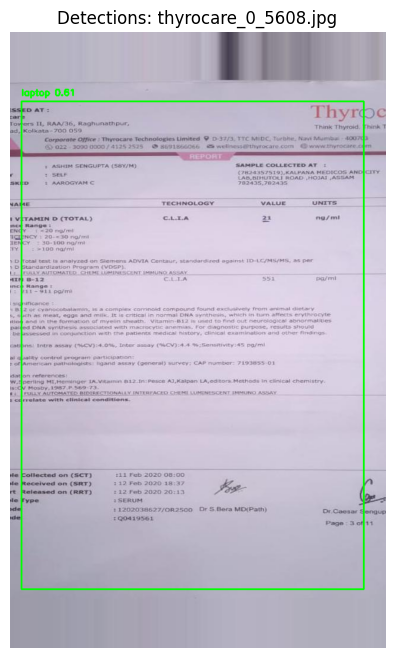


Processing image 60/82: thyrocare_0_5503.jpg
Detected 1 objects
  Object 1: laptop (conf: 0.77)
  Text extracted: Se - Ce sf
SE Ee a TY ae Pa , J - a an
CS anand Mriobinsiatopeshia.
e : io . a Pec re rn td ee ~~ te...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5503.jpg


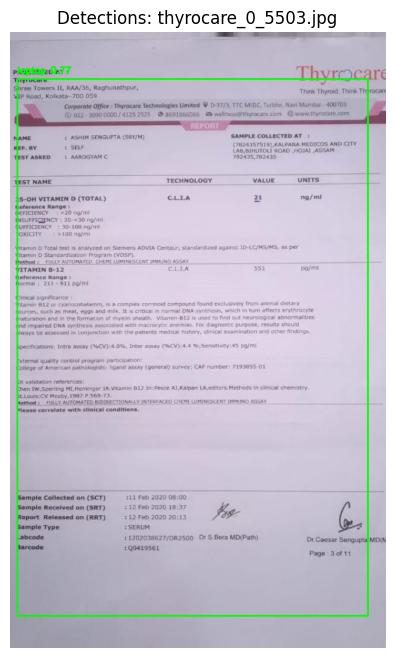


Processing image 61/82: thyrocare_0_4979.jpg
Detected 1 objects
  Object 0: book (conf: 0.58)
  Text extracted: eon pct bree, Mette, Beatie Didi bidedtahs) he} 1 . -
De aU Wa
Corporate Office : Thyrocare Technolo...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4979.jpg


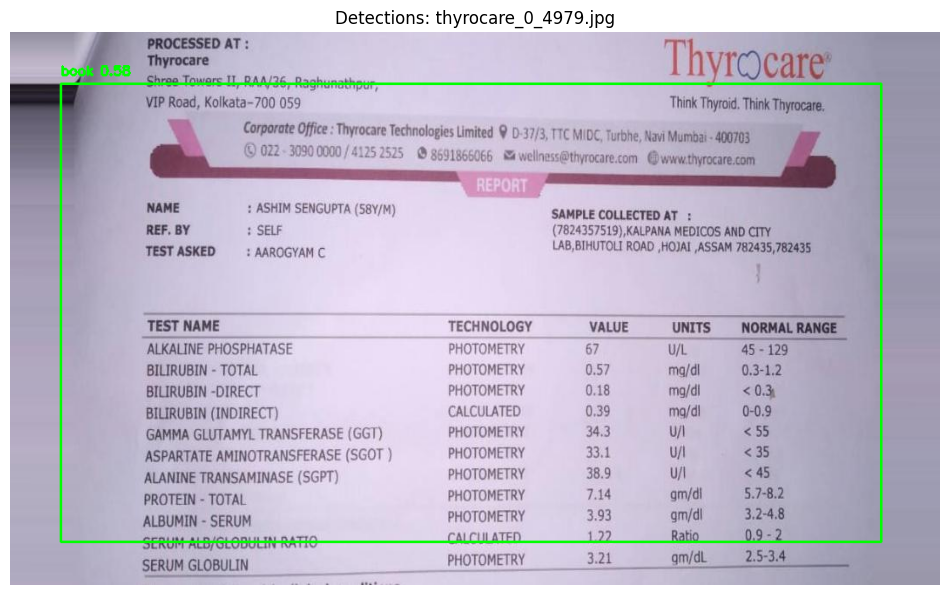


Processing image 62/82: thyrocare_0_4557.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.72)
  Text extracted: Pewee sn decried  cietnld Se
Pho Bi Tae ; a ; ; pacaat Cigtaleitht 76:
. . oe ve slots a PTET a, ” P...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_4557.jpg


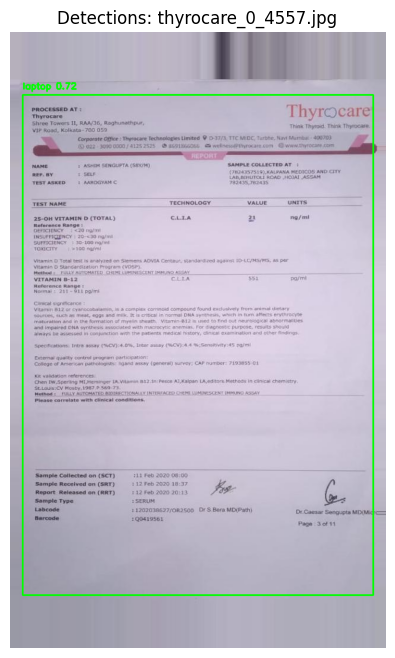


Processing image 63/82: thyrocare_0_5858.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5858.jpg


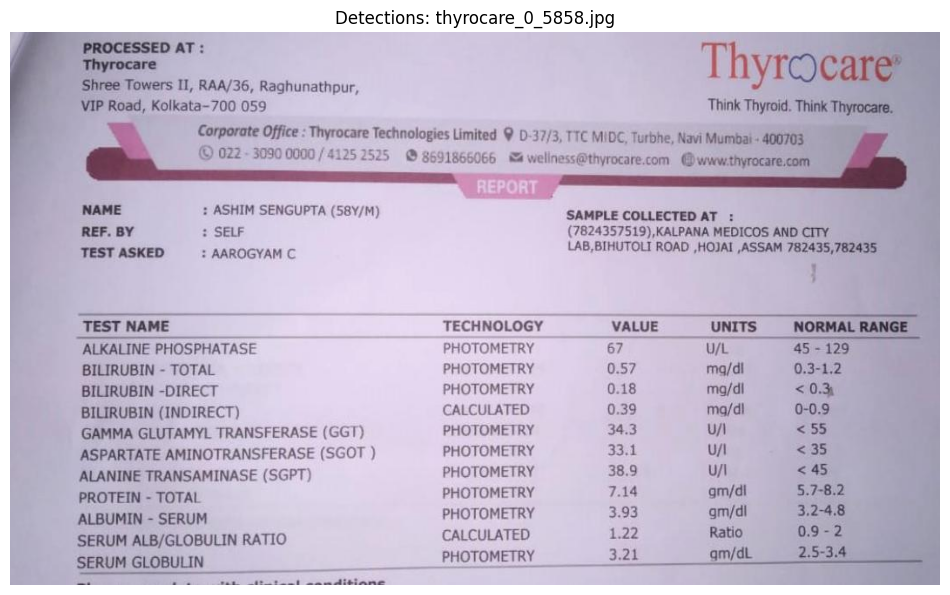


Processing image 64/82: thyrocare_0_5074.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5074.jpg


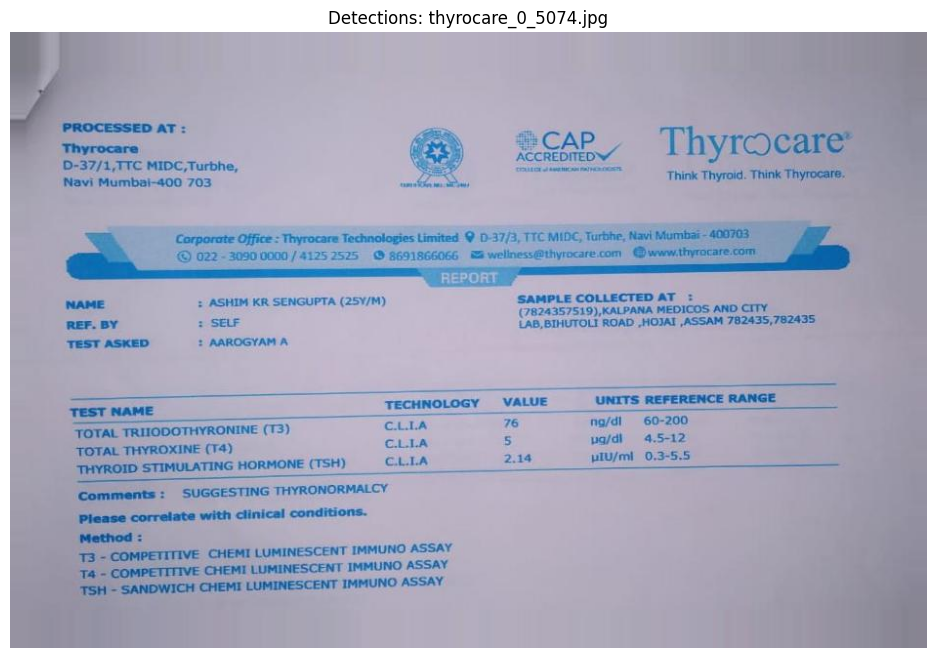


Processing image 65/82: thyrocare_0_5640.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5640.jpg


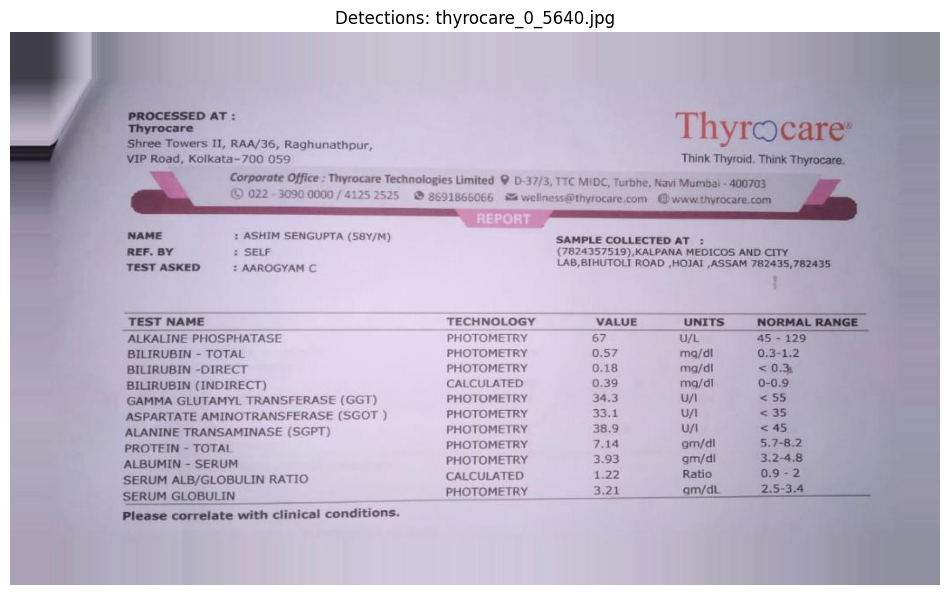


Processing image 66/82: thyrocare_0_5357.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.76)
  Text extracted: Lo AEE St a a Aer
: Be eg ae cteatenzan BOYLE Saneen RA ete
te Les. doe nr abe meses secdreo bf saan...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5357.jpg


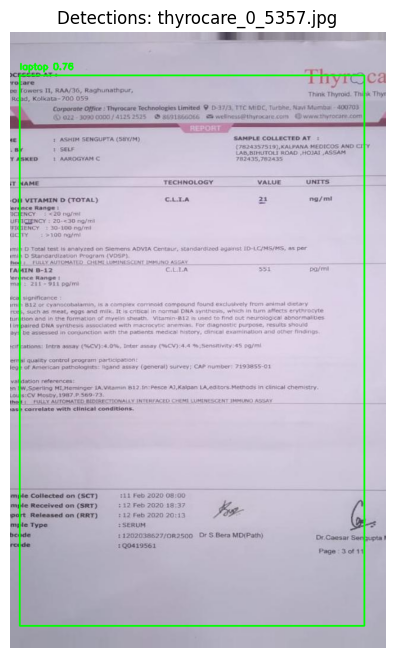


Processing image 67/82: thyrocare_0_5338.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5338.jpg


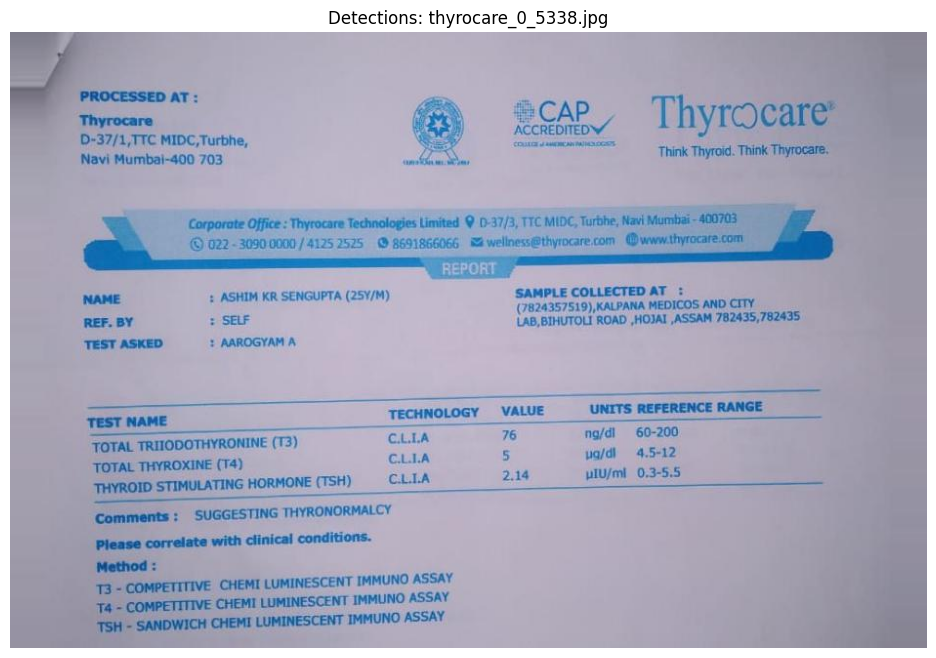


Processing image 68/82: thyrocare_0_5816.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5816.jpg


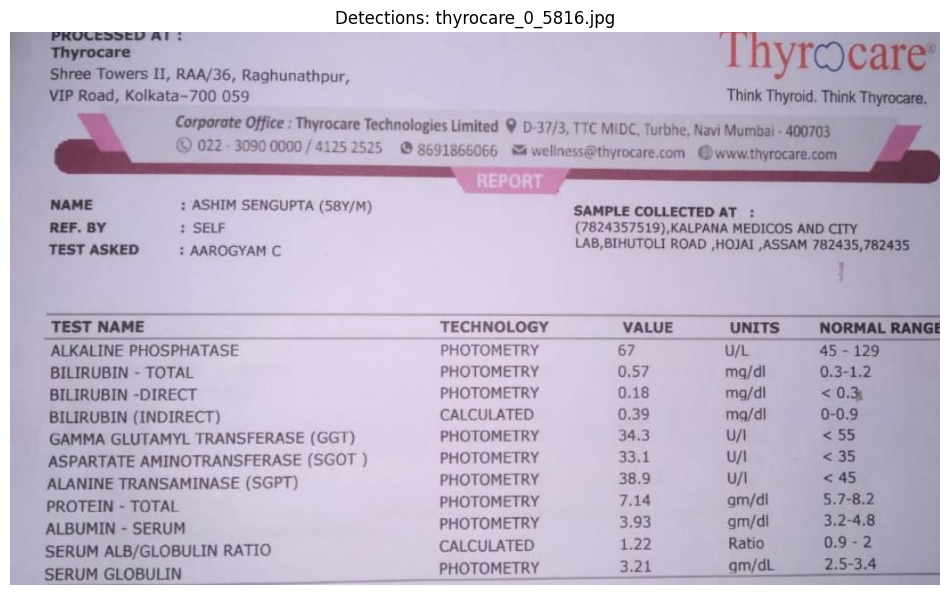


Processing image 69/82: thyrocare_0_5879.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5879.jpg


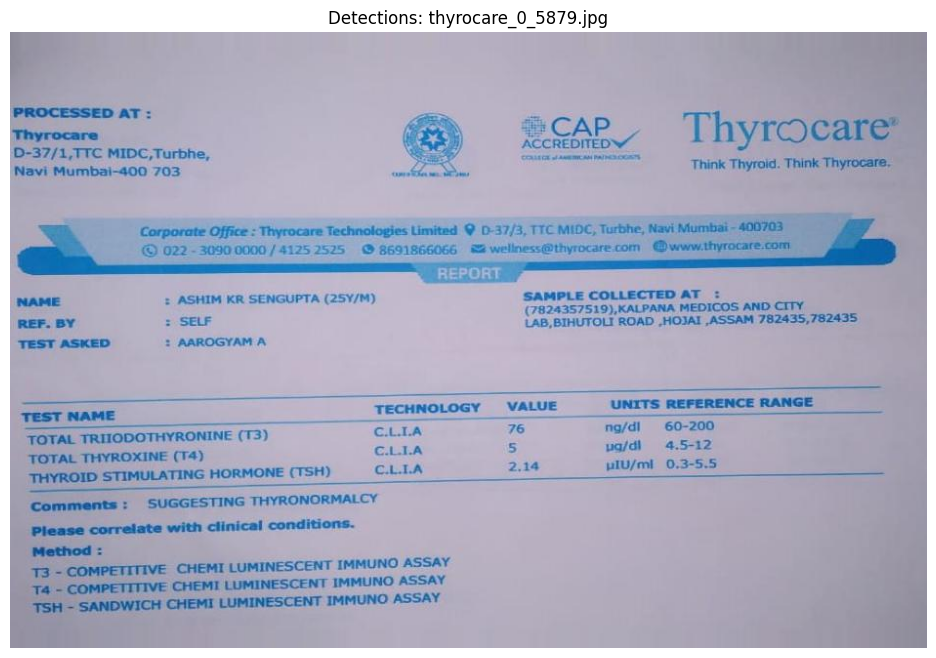


Processing image 70/82: thyrocare_0_6884.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_6884.jpg


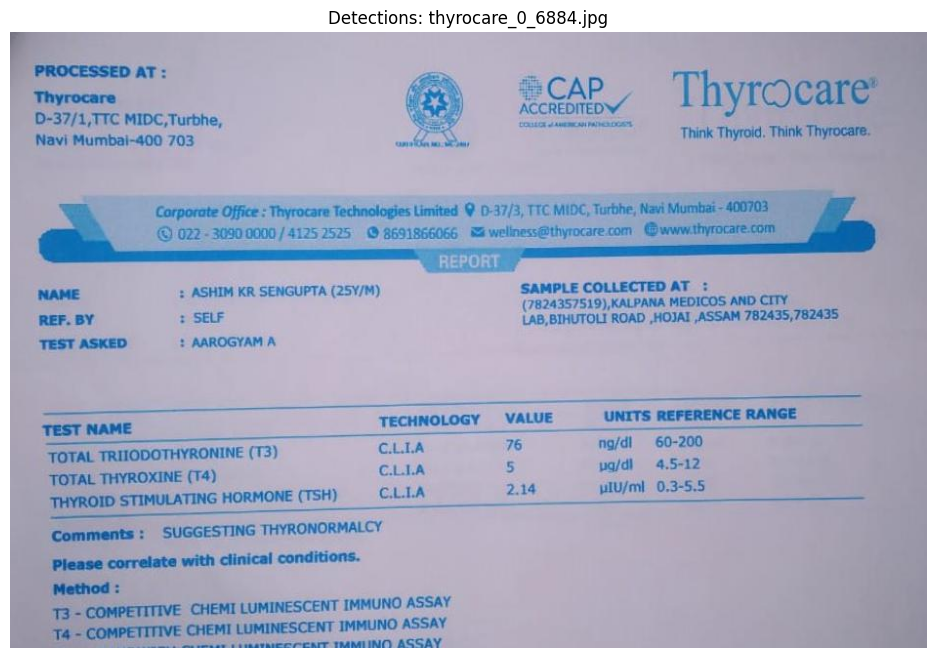


Processing image 71/82: thyrocare_0_6743.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_6743.jpg


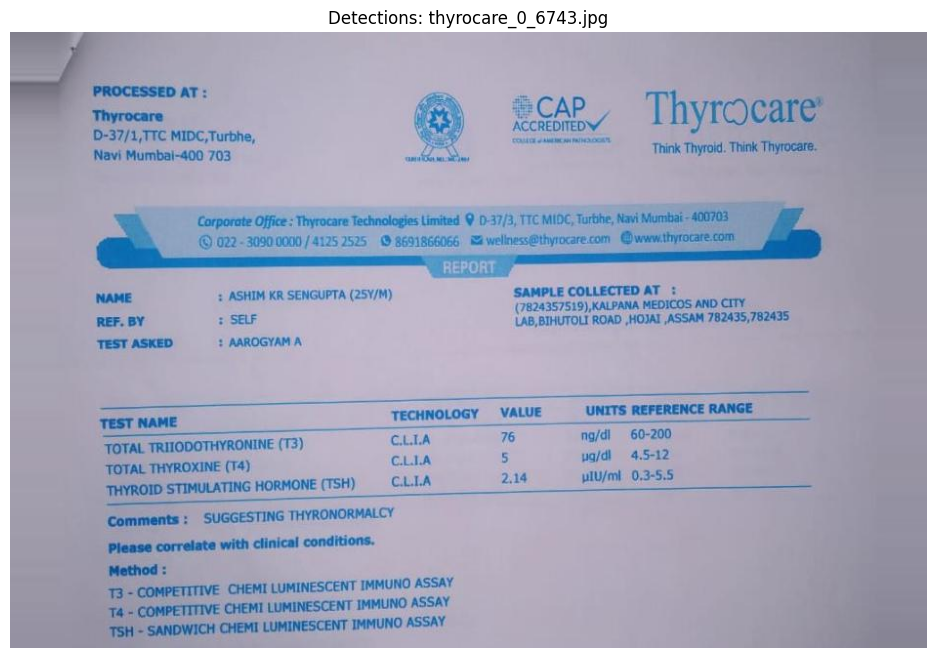


Processing image 72/82: thyrocare_0_6723.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_6723.jpg


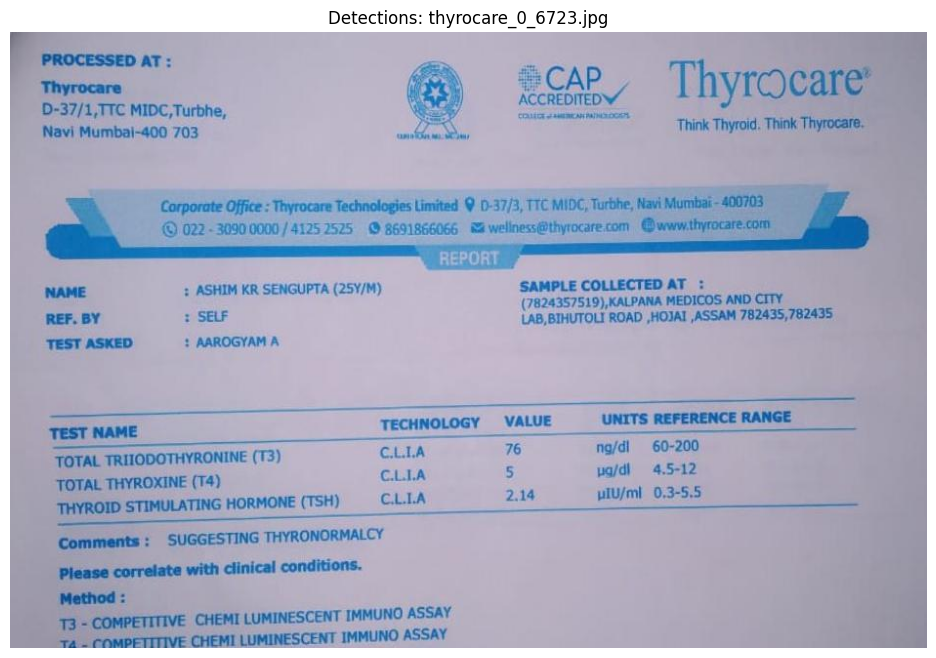


Processing image 73/82: thyrocare_0_6214.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.74)
  Text extracted: “Lot ‘ CDA BSE TE ee ee SIR oe ARE aA ASS 9, BE TEAR BEDALE Ls) ESA ss 2?
a SR ye OTA Bane § fe ae i...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_6214.jpg


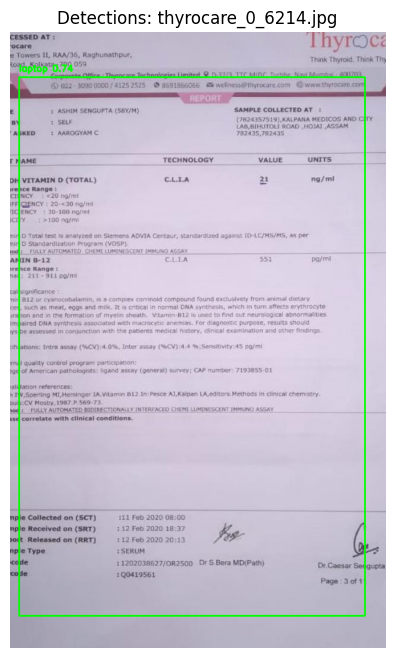


Processing image 74/82: thyrocare_0_6222.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.54)
  Text extracted: - So Fon pS AS czanenatesemed gS " rie NM
Lge eed oigebnciana honasciblisa
° 2 oe SEE reg tet Le tre...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_6222.jpg


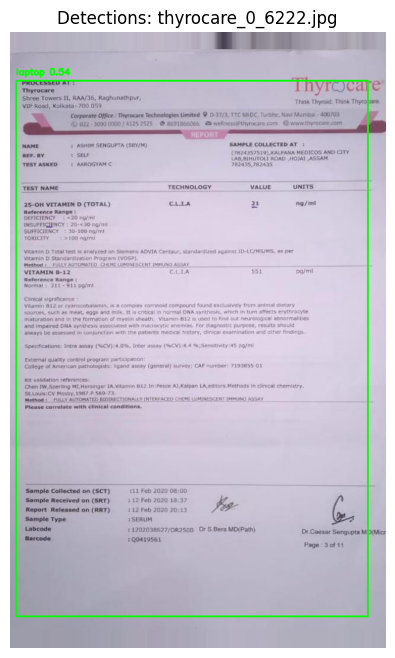


Processing image 75/82: thyrocare_0_6698.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.70)
  Text extracted: OU ey Le peel tanaes
: vores ae ra ea HELI Oe rear oe ‘ Ta, , meet Rr ge PET Be ae
o vt ak nS eters ...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_6698.jpg


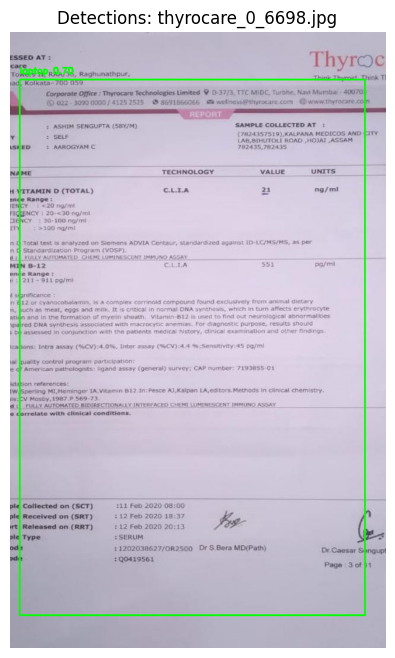


Processing image 76/82: thyrocare_0_6185.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.75)
  Text extracted: oo i ‘Petal coke 7 bad a it la eT ae ot i saa hs
See ——. ee : ee a ae eT Liecep
votes ot tees TyA p ...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_6185.jpg


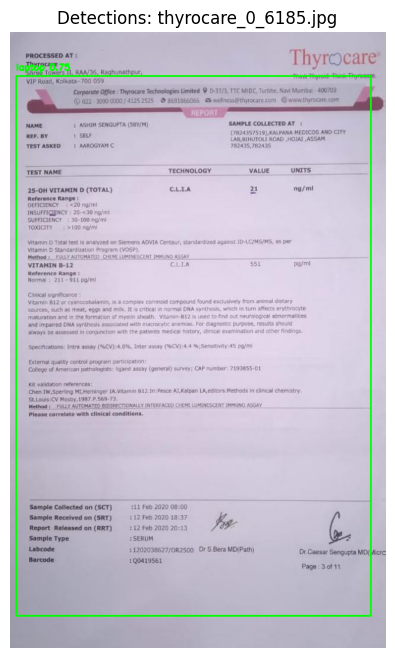


Processing image 77/82: thyrocare_0_5896.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.54)
  Text extracted: bed as a — Co | a
fas We TA ce
ae ae BE "i Ges
ert Ag ST PAS EP ioper air
ve et a PLS) Es Spratt 22 ...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5896.jpg


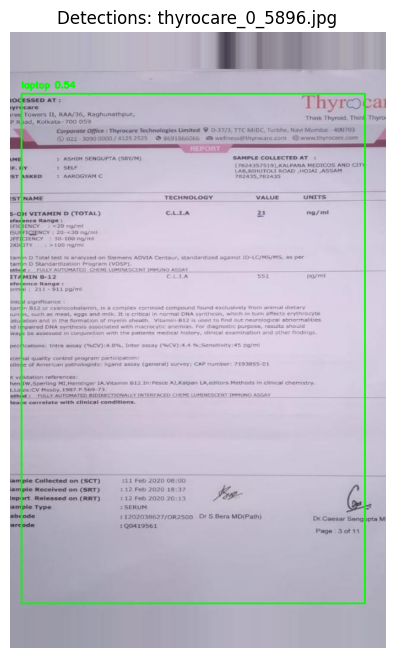


Processing image 78/82: thyrocare_0_5928.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.62)
  Text extracted: . coment ay oe eee ee | rove. . : a
4 De Lola yA ue Ps pala 2 ania kd y Le) ea BBN , ;
. 2 2 res nee...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_5928.jpg


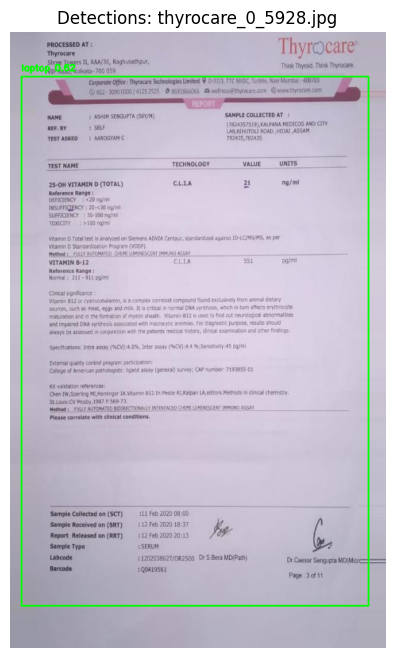


Processing image 79/82: thyrocare_0_6716.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_6716.jpg


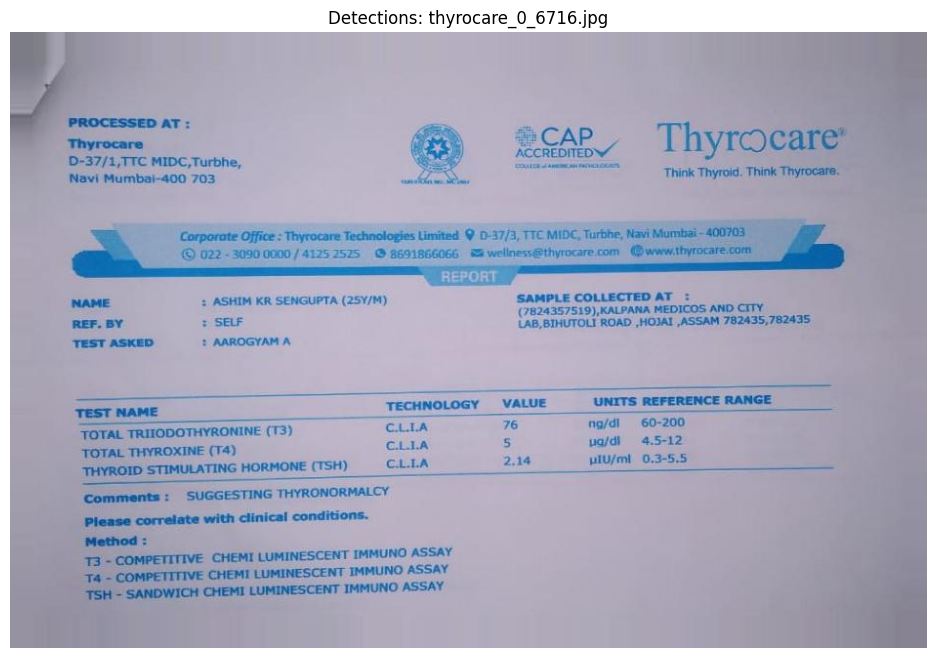


Processing image 80/82: thyrocare_0_7083.jpg
Detected 1 objects
  Object 0: laptop (conf: 0.75)
  Text extracted: roe 13570 Se oe eteane’” (uniter demas
ee eR a ee al] eR ae
6 TY Ogg OR pee tacall ;! 4
. - : “ “ oe...
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7083.jpg


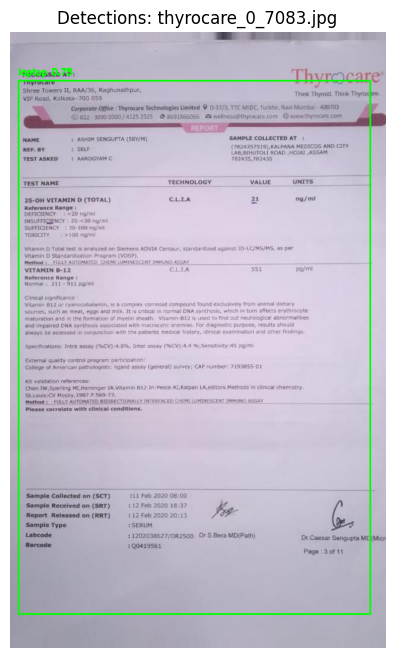


Processing image 81/82: thyrocare_0_7075.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7075.jpg


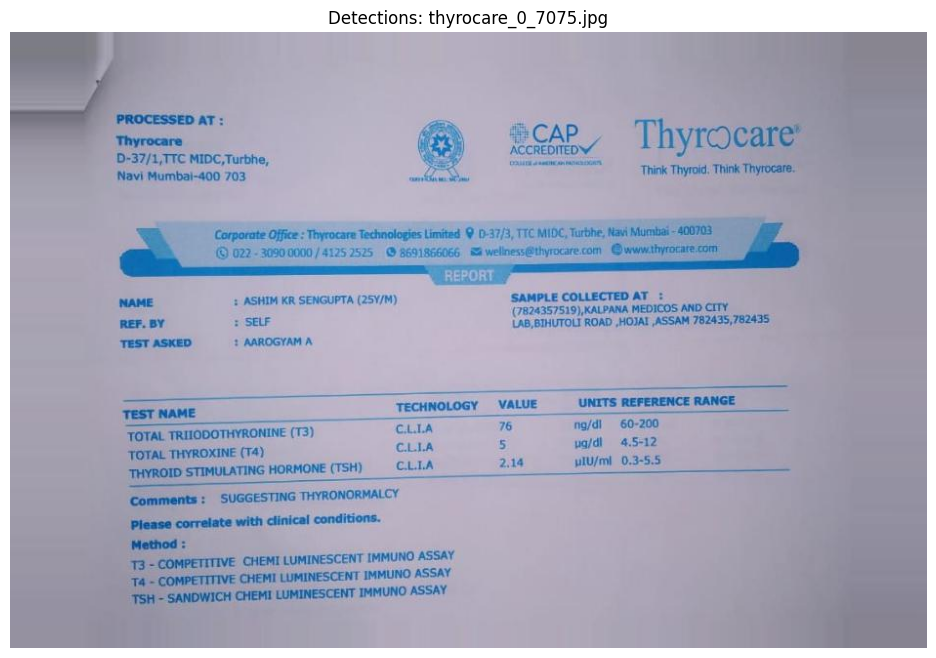


Processing image 82/82: thyrocare_0_7758.jpg
Detected 0 objects
✓ Saved detection visualization to: /content/drive/MyDrive/OCR_Project1/results/detected_thyrocare_0_7758.jpg


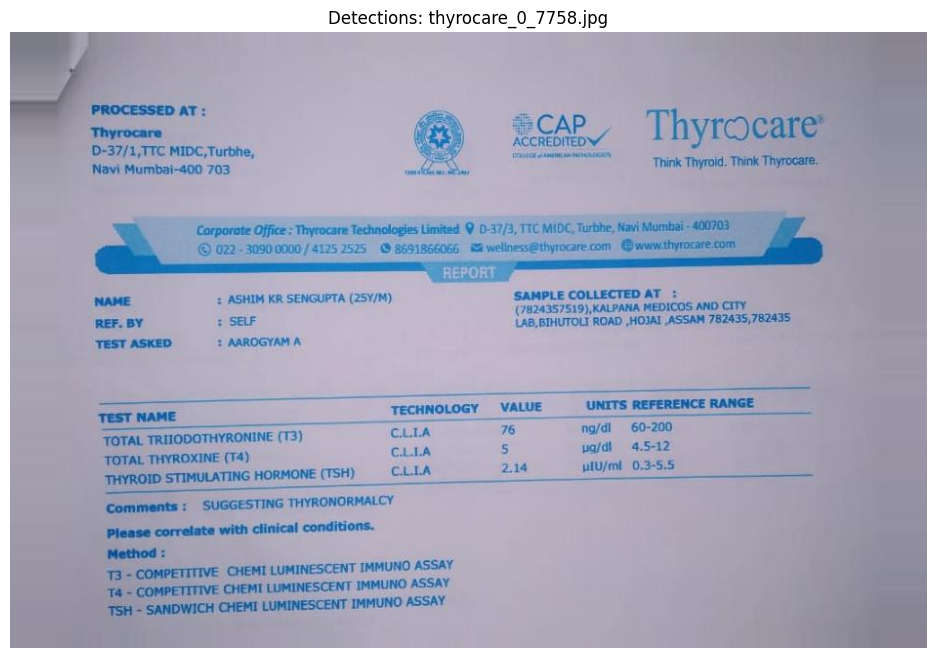

In [28]:
# ============================================================================
# STEP 6: PROCESS IMAGES WITH YOLO + TESSERACT
# ============================================================================

# Get all images from dataset
image_files = glob.glob(DATASET_PATH + '*.jpg') + glob.glob(DATASET_PATH + '*.png')

if len(image_files) == 0:
    print("⚠ No images found! Please upload images to:", DATASET_PATH)
else:
    print(f"✓ Found {len(image_files)} images to process")

# Store all results
all_results = []

# Process each image
for img_idx, image_path in enumerate(image_files):
    print(f"\n{'='*60}")
    print(f"Processing image {img_idx + 1}/{len(image_files)}: {os.path.basename(image_path)}")
    print(f"{'='*60}")

    # Load image
    image = cv2.imread(image_path)
    height, width, channels = image.shape

    # Prepare image for YOLO
    blob = cv2.dnn.blobFromImage(image, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(output_layers)

    # Information to show on screen
    confidences = []
    boxes = []
    class_ids = []

    # Process YOLO detections
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]

            if confidence > 0.5:  # Confidence threshold
                # Object detected
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    # Apply Non-Maximum Suppression
    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

    print(f"Detected {len(indexes)} objects")

    # Create a copy for visualization
    image_with_boxes = image.copy()

    # Process each detected object
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            confidence = confidences[i]

            # Draw bounding box on visualization image
            color = (0, 255, 0)
            cv2.rectangle(image_with_boxes, (x, y), (x + w, y + h), color, 2)
            cv2.putText(image_with_boxes, f"{label} {confidence:.2f}",
                       (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

            # Crop the detected region
            cropped = image[max(0, y):min(height, y + h), max(0, x):min(width, x + w)]

            if cropped.size > 0:
                # Preprocess for OCR
                processed = preprocess_for_ocr(cropped)

                # Apply Tesseract OCR
                text = pytesseract.image_to_string(processed, config='--psm 6')
                text = text.strip()

                if text:  # Only save if text was detected
                    result = {
                        'image_name': os.path.basename(image_path),
                        'object_id': i,
                        'class': label,
                        'confidence': confidence,
                        'x': x,
                        'y': y,
                        'width': w,
                        'height': h,
                        'extracted_text': text
                    }
                    all_results.append(result)

                    print(f"  Object {i}: {label} (conf: {confidence:.2f})")
                    print(f"  Text extracted: {text[:100]}...")  # Show first 100 chars

    # Save image with bounding boxes
    output_image_path = RESULTS_PATH + f'detected_{os.path.basename(image_path)}'
    cv2.imwrite(output_image_path, image_with_boxes)
    print(f"✓ Saved detection visualization to: {output_image_path}")

    # Display the result (optional, comment out for faster processing)
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(image_with_boxes, cv2.COLOR_BGR2RGB))
    plt.title(f"Detections: {os.path.basename(image_path)}")
    plt.axis('off')
    plt.show()

In [29]:
# ============================================================================
# STEP 7: SAVE RESULTS TO CSV
# ============================================================================

if all_results:
    df = pd.DataFrame(all_results)
    csv_path = RESULTS_PATH + 'ocr_results.csv'
    df.to_csv(csv_path, index=False)

    print(f"\n{'='*60}")
    print(f" SUCCESS! Results saved to: {csv_path}")
    print(f"{'='*60}")
    print(f"\nTotal detections: {len(all_results)}")
    print(f"\nFirst few results:")
    print(df.head())

    # Save summary
    summary = f"""
OCR Processing Summary
{'='*60}
Total images processed: {len(image_files)}
Total objects detected: {len(all_results)}
Output CSV: {csv_path}
Detection images: {RESULTS_PATH}

Classes detected: {df['class'].unique().tolist()}
{'='*60}
"""

    summary_path = RESULTS_PATH + 'summary.txt'
    with open(summary_path, 'w') as f:
        f.write(summary)

    print(f"\n Summary saved to: {summary_path}")

else:
    print("\n No text extracted from any images. Please check:")
    print("  1. Images are in the correct path")
    print("  2. Images contain detectable objects")
    print("  3. YOLO model is working correctly")



 SUCCESS! Results saved to: /content/drive/MyDrive/OCR_Project1/results/ocr_results.csv

Total detections: 25

First few results:
             image_name  object_id   class  confidence   x    y  width  \
0  thyrocare_0_8310.jpg          0  laptop    0.583358  19  104    586   
1  thyrocare_0_8265.jpg          0  laptop    0.714201  11   71    601   
2  thyrocare_0_8231.jpg          1  laptop    0.724342  16   69    592   
3  thyrocare_0_8491.jpg          0  laptop    0.684776  10   76    603   
4  thyrocare_0_9445.jpg          0  laptop    0.644107  13   81    597   

   height                                     extracted_text  
0     860  | oom on | =\noa mt Zi...\nwoe at =, OR Cn\nOl...  
1     911  wy ke Pree vor Ooetell 7 ee\noe vie ee RL Re S...  
2     906  REPORT\nHANS ¢ ASHIM SENGUPTA (S8Y/M) SAMPLE C...  
3     920  wT - cnt on Be 1. Yeu -\nCassiae fag BGR Agel ...  
4     908  i\npeo oo rr ek\n“eet 7 ga BGR Use lOre et -\n...  

 Summary saved to: /content/drive/MyDrive/OCR

In [30]:
# ============================================================================
# STEP 8: TEST ON A SINGLE IMAGE
# ============================================================================

print(f"\n{'='*60}")
print("To test on a single image, use the code below:")
print(f"{'='*60}")

test_code = """
# Test on a single image
test_image_path = DATASET_PATH + 'your_image.jpg'  # Change this
image = cv2.imread(test_image_path)

# Run YOLO detection
blob = cv2.dnn.blobFromImage(image, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
net.setInput(blob)
outs = net.forward(output_layers)

# Process and extract text (same logic as above)
# ... (copy the processing loop from above)
"""

print(" Project completed successfully!")
print("\nYour files are saved in:")
print(f"  - CSV Results: {RESULTS_PATH}ocr_results.csv")
print(f"  - Detection Images: {RESULTS_PATH}")
print(f"  - Summary: {RESULTS_PATH}summary.txt")


To test on a single image, use the code below:
 Project completed successfully!

Your files are saved in:
  - CSV Results: /content/drive/MyDrive/OCR_Project1/results/ocr_results.csv
  - Detection Images: /content/drive/MyDrive/OCR_Project1/results/
  - Summary: /content/drive/MyDrive/OCR_Project1/results/summary.txt
